# The stability of the global average on different window lengths
This notebook outllines different methods that can be used to de-trend the LongRunMIP and ZECMIP time series.

In [1]:
# Standard Library Imports
import os
import sys
from typing import List, Any, Callable, Union, Tuple, Optional
from importlib import reload

# Third-Party Library Imports
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cf
from pprint import pprint
from functools import partial
from glob import glob
import cftime
import json
import string

# Custom Module Imports
sys.path.append(os.path.join(os.getcwd(), 'Documents', 'PhD'))
import constants
sys.path.append(constants.MODULE_DIR)
import open_ds
import open_zecmip
import utils
import signal_to_noise as sn
import plotting_functions
import xarray_extender as xe
import zec_calculation_functions
import drift_functions
import sn_plotting
import stats

# Suppress Warnings
import warnings
warnings.filterwarnings('ignore')

# Logging
logger = utils.get_notebook_logger()

Matplotlib created a temporary config/cache directory at /jobfs/114427152.gadi-pbs/matplotlib-wn_a9mvy because the default path (/home/563/ab2313/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [2]:
xr.set_options(display_expand_data=False)

In [3]:
import listXarray as lxr
reload(lxr)
from listXarray import listXarray

In [289]:
# client.close()

In [290]:
from dask.distributed import Client
client = Client()
client

- State start
-   Scheduler at:     tcp://127.0.0.1:34179
-   dashboard at:         /proxy/8787/status
- Registering Worker plugin shuffle
-         Start Nanny at: 'tcp://127.0.0.1:36497'
-         Start Nanny at: 'tcp://127.0.0.1:33167'
-         Start Nanny at: 'tcp://127.0.0.1:43123'
-         Start Nanny at: 'tcp://127.0.0.1:44379'
-         Start Nanny at: 'tcp://127.0.0.1:46589'
-         Start Nanny at: 'tcp://127.0.0.1:39221'
-         Start Nanny at: 'tcp://127.0.0.1:40389'
- Register worker <WorkerState 'tcp://127.0.0.1:34121', name: 2, status: init, memory: 0, processing: 0>
- Starting worker compute stream, tcp://127.0.0.1:34121
- Starting established connection to tcp://127.0.0.1:45952
- Register worker <WorkerState 'tcp://127.0.0.1:42785', name: 1, status: init, memory: 0, processing: 0>
- Starting worker compute stream, tcp://127.0.0.1:42785
- Starting established connection to tcp://127.0.0.1:45974
- Register worker <WorkerState 'tcp://127.0.0.1:34973', name: 0, status

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 7
Total threads: 28,Total memory: 251.18 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:34179,Workers: 7
Dashboard: /proxy/8787/status,Total threads: 28
Started: Just now,Total memory: 251.18 GiB
Comm: tcp://127.0.0.1:34973,Total threads: 4
Dashboard: /proxy/36503/status,Memory: 35.88 GiB
Nanny: tcp://127.0.0.1:36497,


# Opening Data

In [6]:
chunks = {'lat':-1, 'lon':-1, 'time':-1, 'ensemble':-1}

In [7]:
a1_raw_xrlist = (open_zecmip.extract_experiment_into_xrlist('1000pgc', 'tas', chunks=chunks, logginglevel='ERROR')
                 .to_dataarray('tas')
                 .sort_by_refkey())

0.3.0


In [8]:
pct_raw_xrlist =  (open_zecmip.extract_experiment_into_xrlist('1pct', 'tas', chunks=chunks)
                   .to_dataarray('tas')
                   .sort_by_refkey())

In [9]:
# pi-Control (not ESM)
esmpi_raw_xrlist = (open_zecmip.extract_experiment_into_xrlist('picontrol', 'tas', chunks=chunks, logginglevel='INFO')
                    .to_dataarray('tas')
                    .isel(ensemble=0)
                    .squeeze('ensemble')
                    .sort_by_refkey()
                    .rename({'latitude':'lat', 'longitude': 'lon'}))

- ACCESS-ESM1-5
-      r1i1p1f1 - /g/data/fs38/publications/CMIP6/CMIP/CSIRO/ACCESS-ESM1-5/piControl/r1i1p1f1/Amon/tas/gn/v20210316/*.nc
- CanESM5
-      r1i1p1f1 - /g/data/oi10/replicas/CMIP6/CMIP/CCCma/CanESM5/piControl/r1i1p1f1/Amon/tas/gn/v20190429/*.nc
-      r1i1p2f1 - /g/data/oi10/replicas/CMIP6/CMIP/CCCma/CanESM5/piControl/r1i1p2f1/Amon/tas/gn/v20190429/*.nc
- MIROC-ES2L
-      r1i1p1f2 - /g/data/oi10/replicas/CMIP6/CMIP/MIROC/MIROC-ES2L/piControl/r1i1p1f2/Amon/tas/gn/v20190823/*.nc
- UKESM1-0-LL
-      r1i1p1f2 - /g/data/oi10/replicas/CMIP6/CMIP/MOHC/UKESM1-0-LL/piControl/r1i1p1f2/Amon/tas/gn/v20200828/*.nc
- MPI-ESM1-2-LR
-      r1i1p1f1 - /g/data/oi10/replicas/CMIP6/CMIP/MPI-M/MPI-ESM1-2-LR/piControl/r1i1p1f1/Amon/tas/gn/v20190710/*.nc
-      r2i1p1f1 - /g/data/oi10/replicas/CMIP6/CMIP/MPI-M/MPI-ESM1-2-LR/piControl/r2i1p1f1/Amon/tas/gn/v20190815/*.nc
- GISS-E2-1-G-CC
-      r1i1p1f1 - /g/data/oi10/replicas/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G-CC/piControl/r1i1p1f1/Amon/tas/gn/v2

In [10]:
### ESM-pi-Control
# esmpi_raw_xrlist = (open_zecmip.extract_experiment_into_xrlist('esm-piControl', 'tas', logginglevel='INFO') #esm-piControl'
#                     .to_dataarray('tas')
#                     # .isel(ensemble=0)
#                     # .squeeze('ensemble')
#                     .sort_by_refkey()
#                     .rename({'latitude':'lat', 'longitude': 'lon'}))

In [11]:
esmpi_raw_xrlist

key_dim = model


Number of da/ds: 9
---------------
ACCESS-ESM1-5 ({'model': 1, 'time': 12000, 'lat': 145, 'lon': 192})
CESM2         ({'model': 1, 'time': 14400, 'lat': 192, 'lon': 288})
CanESM5       ({'model': 1, 'time': 16800, 'lat': 64, 'lon': 128})
GFDL-ESM4     ({'model': 1, 'time': 6000, 'lat': 180, 'lon': 288})
GISS-E2-1-G-CC({'model': 1, 'time': 1980, 'lat': 90, 'lon': 144})
MIROC-ES2L    ({'model': 1, 'time': 6000, 'lat': 64, 'lon': 128})
MPI-ESM1-2-LR ({'model': 1, 'time': 12000, 'lat': 96, 'lon': 192})
NorESM2-LM    ({'model': 1, 'time': 6012, 'lat': 96, 'lon': 144})
UKESM1-0-LL   ({'model': 1, 'time': 22560, 'lat': 144, 'lon': 192})

In [12]:
# Making sure that the ensembles match. NOTE -  this can not be done
# with the piControl
a1_raw_xrlist = a1_raw_xrlist.cross_match_dim(pct_raw_xrlist, 'ensemble')
pct_raw_xrlist = pct_raw_xrlist.cross_match_dim(a1_raw_xrlist, 'ensemble')

In [13]:
# We are just looking at a single ensemble here.
a1_raw_xrlist = a1_raw_xrlist.isel(ensemble=0)
pct_raw_xrlist = pct_raw_xrlist.isel(ensemble=0)
esmpi_raw_xrlist = esmpi_raw_xrlist.isel(ensemble=0)

In [14]:
mask_ds = xr.open_dataset(os.path.join(constants.ZECMIP_LOCAL_REGRIDDED_DIR, 'landsea_mask.nc')); mask_ds

<xarray.Dataset>
Dimensions:  (lat: 96, lon: 192)
Coordinates:
  * lat      (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 83.0 84.86 86.72 88.57
  * lon      (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
Data variables:
    mask     (lat, lon) int64 ...
Attributes:
    Original model:  Made from data found at /g/data/oi10/replicas/CMIP6/C4MI...

In [15]:
# Convert to celcius
a1_raw_xrlist = a1_raw_xrlist - 273.15
pct_raw_xrlist = pct_raw_xrlist - 273.15
esmpi_raw_xrlist = esmpi_raw_xrlist - 273.15

In [16]:
esmpi_regrid_xrlist = esmpi_raw_xrlist.chunk('auto').regrid('MPI-ESM1-2-LR', 'bilinear')
pct_regrid_xrlist = pct_raw_xrlist.chunk('auto').regrid('MPI-ESM1-2-LR', 'bilinear')
a1_regrid_xrlist = a1_raw_xrlist.chunk('auto').regrid('MPI-ESM1-2-LR', 'bilinear')

In [17]:
# Yearly data transfomration - montly resolution is not needed
esmpi_xrlist = esmpi_regrid_xrlist.chunk({'time':-1}).resample(time='Y').mean(dim='time').set_refkeys('model')
pct_xrlist = pct_regrid_xrlist.chunk({'time':-1}).resample(time='Y').mean(dim='time').set_refkeys('model')
a1_xrlist = a1_regrid_xrlist.chunk({'time':-1}).resample(time='Y').mean(dim='time').set_refkeys('model')

In [18]:
# Can see this in the global mean time series. But this has errors after 1000
esmpi_xrlist['CanESM5'] = esmpi_xrlist['CanESM5'].isel(time=slice(None, 1000))

In [19]:
a1_xrlist

key_dim = model


Number of da/ds: 9
---------------
MPI-ESM1-2-LR ({'model': 1, 'time': 185, 'lat': 96, 'lon': 192})
ACCESS-ESM1-5 ({'model': 1, 'time': 101, 'lat': 96, 'lon': 192})
CESM2         ({'model': 1, 'time': 150, 'lat': 96, 'lon': 192})
CanESM5       ({'model': 1, 'time': 100, 'lat': 96, 'lon': 192})
GFDL-ESM4     ({'model': 1, 'time': 200, 'lat': 96, 'lon': 192})
GISS-E2-1-G-CC({'model': 1, 'time': 180, 'lat': 96, 'lon': 192})
MIROC-ES2L    ({'model': 1, 'time': 248, 'lat': 96, 'lon': 192})
NorESM2-LM    ({'model': 1, 'time': 100, 'lat': 96, 'lon': 192})
UKESM1-0-LL   ({'model': 1, 'time': 330, 'lat': 96, 'lon': 192})

In [20]:
esmpi_xrlist

key_dim = model


Number of da/ds: 9
---------------
MPI-ESM1-2-LR ({'model': 1, 'time': 1000, 'lat': 96, 'lon': 192})
ACCESS-ESM1-5 ({'model': 1, 'time': 1000, 'lat': 96, 'lon': 192})
CESM2         ({'model': 1, 'time': 1200, 'lat': 96, 'lon': 192})
CanESM5       ({'model': 1, 'time': 1000, 'lat': 96, 'lon': 192})
GFDL-ESM4     ({'model': 1, 'time': 500, 'lat': 96, 'lon': 192})
GISS-E2-1-G-CC({'model': 1, 'time': 165, 'lat': 96, 'lon': 192})
MIROC-ES2L    ({'model': 1, 'time': 500, 'lat': 96, 'lon': 192})
NorESM2-LM    ({'model': 1, 'time': 501, 'lat': 96, 'lon': 192})
UKESM1-0-LL   ({'model': 1, 'time': 1880, 'lat': 96, 'lon': 192})

In [21]:
# Time Subsetting
# Subsetting to only first 150 years so all models have equal footing
#esmpi_xrlist = esmpi_xrlist.isel(time=slice(None, 150))

# Reduce time so that the smalles time densions matches. This is at 101 years
a1_xrlist = a1_xrlist.isel(time=slice(None, 100))

In [22]:
# Base period calculation - 20 year average at branch poin
branch_point_mean_xrlist = listXarray([zec_calculation_functions.calculate_branch_average(
    pct_xrlist[model], a1_xrlist[model], logginglevel='INFO') for model in pct_xrlist.refkeys]).set_refkeys('model')

- ['MPI-ESM1-2-LR'] - ['MPI-ESM1-2-LR']
- branch_start_time=cftime.DatetimeProlepticGregorian(1915, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=65
- 

- ['ACCESS-ESM1-5'] - ['ACCESS-ESM1-5']
- branch_start_time=cftime.DatetimeProlepticGregorian(168, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=67
- 

- ['CESM2'] - ['CESM2']
- branch_start_time=cftime.DatetimeNoLeap(68, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=67
- 

- ['CanESM5'] - ['CanESM5']
- branch_start_time=cftime.DatetimeNoLeap(1911, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=61
- 

- ['GFDL-ESM4'] - ['GFDL-ESM4']
- branch_start_time=cftime.DatetimeNoLeap(64, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=63
- 

- ['GISS-E2-1-G-CC'] - ['GISS-E2-1-G-CC']
- branch_start_time=cftime.DatetimeNoLeap(1920, 12, 31, 0, 0, 0, 0, has_year_zero=True)
- onepct_branch_arg=70
- 

- ['MIROC-ES2L'] - ['MIROC-ES2L']
- branch_start_time=cftime.DatetimeGregorian(1913, 

In [23]:
# Amomaly time series from the branch point (previosuly called 'experiment_zec_da_anom')
a1_anom_xrlist = (a1_xrlist - branch_point_mean_xrlist)#.compute()

In [24]:
# This way procudes the same as when you average first then take the anomalies. However, we also get the anomaleis
# time series which is useful
zec25_xrlist = a1_anom_xrlist.isel(time=slice(15, 35)).mean(dim='time')
zec50_xrlist = a1_anom_xrlist.isel(time=slice(40, 60)).mean(dim='time')
zec50_xrlist

key_dim = model


Number of da/ds: 9
---------------
MPI-ESM1-2-LR ({'model': 1, 'lat': 96, 'lon': 192})
ACCESS-ESM1-5 ({'model': 1, 'lat': 96, 'lon': 192})
CESM2         ({'model': 1, 'lat': 96, 'lon': 192})
CanESM5       ({'model': 1, 'lat': 96, 'lon': 192})
GFDL-ESM4     ({'model': 1, 'lat': 96, 'lon': 192})
GISS-E2-1-G-CC({'model': 1, 'lat': 96, 'lon': 192})
MIROC-ES2L    ({'model': 1, 'lat': 96, 'lon': 192})
NorESM2-LM    ({'model': 1, 'lat': 96, 'lon': 192})
UKESM1-0-LL   ({'model': 1, 'lat': 96, 'lon': 192})

In [25]:
np.take(esmpi_xrlist.dim('time', output='dict')['CanESM5'], [0,1,2,-3,-2,-1])

array([cftime.DatetimeNoLeap(5201, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(5202, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(5203, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(6198, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(6199, 12, 31, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(6200, 12, 31, 0, 0, 0, 0, has_year_zero=True)],
      dtype=object)

In [26]:
# Reset to time zero
a1_anom_xrlist = a1_anom_xrlist.apply(utils.reset_time_to_0_start)
pct_xrlist = pct_xrlist.apply(utils.reset_time_to_0_start)
esmpi_xrlist = esmpi_xrlist.apply(utils.reset_time_to_0_start)

In [27]:
np.take(esmpi_xrlist.dim('time', output='dict')['CanESM5'], [0,1,2,-3,-2,-1])

array([cftime.datetime(1, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(2, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(3, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(998, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(999, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False),
       cftime.datetime(1000, 12, 31, 0, 0, 0, 0, calendar='standard', has_year_zero=False)],
      dtype=object)

In [28]:
# These two can be computed as they are small (combined is around  100mb with each 
# model being around 7mb
a1_anom_xrlist = a1_anom_xrlist.compute()
pct_xrlist = pct_xrlist.compute()

In [29]:
# Each model is around 100mb. Parallel across this would be great. But would be 
# too much effort for now
esmpi_xrlist = esmpi_xrlist.compute()

In [30]:
esmpi_xrlist

key_dim = model


Number of da/ds: 9
---------------
MPI-ESM1-2-LR ({'model': 1, 'time': 1000, 'lat': 96, 'lon': 192})
ACCESS-ESM1-5 ({'model': 1, 'time': 1000, 'lat': 96, 'lon': 192})
CESM2         ({'model': 1, 'time': 1200, 'lat': 96, 'lon': 192})
CanESM5       ({'model': 1, 'time': 1000, 'lat': 96, 'lon': 192})
GFDL-ESM4     ({'model': 1, 'time': 500, 'lat': 96, 'lon': 192})
GISS-E2-1-G-CC({'model': 1, 'time': 165, 'lat': 96, 'lon': 192})
MIROC-ES2L    ({'model': 1, 'time': 500, 'lat': 96, 'lon': 192})
NorESM2-LM    ({'model': 1, 'time': 501, 'lat': 96, 'lon': 192})
UKESM1-0-LL   ({'model': 1, 'time': 1880, 'lat': 96, 'lon': 192})

# SN Calculation

In [31]:
MODEL_CHUNKS = {'model': 1, 'time':-1, 'lat':-1, 'lon':-1}
MODEL_CHUNKS

{'model': 1, 'time': -1, 'lat': -1, 'lon': -1}

## xr list

In [268]:
%%time
# Detrend the data
a1_anom_trendfit_xrlist = a1_anom_xrlist.apply(stats.trend_fit, method='polynomial', order=3)
a1_anom_detrend_xrlist = a1_anom_xrlist - a1_anom_trendfit_xrlist

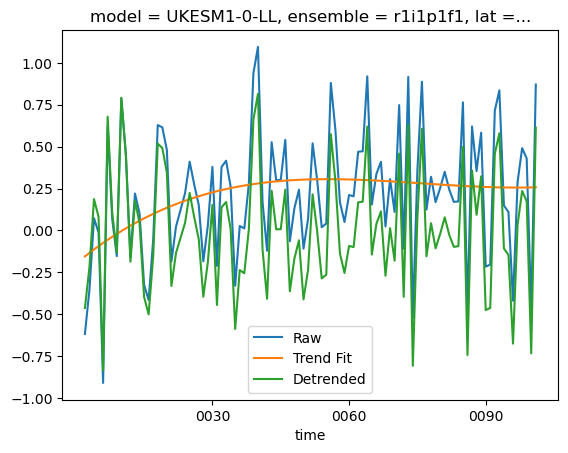

In [34]:
model = 'UKESM1-0-LL'#'CESM2'
ensemble=1
a1_anom_xrlist[model].sel(lat=-39, lon=144, method='nearest').plot(label='Raw')
a1_anom_trendfit_xrlist[model].sel(lat=-39, lon=144, method='nearest').plot(label='Trend Fit')
a1_anom_detrend_xrlist[model].sel(lat=-39, lon=144, method='nearest').plot(label='Detrended')
plt.legend()

In [35]:
%%time
# Time taken ~ 25 minutes

# Calculate thje rolling and non rolling signal to noise
sn_multi_rolling_xrlist = listXarray([sn.multiwindow_signal_to_nosie_and_bounds(
    a1_anom_xrlist[model], esmpi_xrlist[model].drop('ensemble'),
    da_for_noise=a1_anom_detrend_xrlist[model],
    rolling_noise=True, windows=[20, 40],return_all=True, logginglevel='ERROR') 
                                      for model in a1_anom_xrlist.refkeys]).set_refkeys('model').compute()


Experiment
--------
20, 40, 
Concatenating objects - PLEASE be patient!
 - Finished

Control
------

20, 40, 
Concatenating objects - PLEASE be patient!
Persist
Calculating bounds
final merge

Experiment
--------
20, 40, 
Concatenating objects - PLEASE be patient!
 - Finished

Control
------

20, 40, 
Concatenating objects - PLEASE be patient!
Persist
Calculating bounds
final merge

Experiment
--------
20, 40, 
Concatenating objects - PLEASE be patient!
 - Finished

Control
------

20, 40, 
Concatenating objects - PLEASE be patient!
Persist
Calculating bounds
final merge

Experiment
--------
20, 40, 
Concatenating objects - PLEASE be patient!
 - Finished

Control
------

20, 40, 
Concatenating objects - PLEASE be patient!
Persist
Calculating bounds
final merge

Experiment
--------
20, 40, 
Concatenating objects - PLEASE be patient!
 - Finished

Control
------

20, 40, 
Concatenating objects - PLEASE be patient!
Persist
Calculating bounds
final merge

Experiment
--------
20, 40, 
Conca

In [36]:
sn_multi_rolling_xrlist

key_dim = model


Number of da/ds: 9
---------------
MPI-ESM1-2-LR ({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})
ACCESS-ESM1-5 ({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})
CESM2         ({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})
CanESM5       ({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})
GFDL-ESM4     ({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})
GISS-E2-1-G-CC({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})
MIROC-ES2L    ({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})
NorESM2-LM    ({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})
UKESM1-0-LL   ({'lat': 96, 'lon': 192, 'time': 100, 'window': 2})

In [37]:
MODEL_CHUNKS = {'model': 4, 'time':-1, 'lat':-1, 'lon':-1}
MODEL_CHUNKS

{'model': 4, 'time': -1, 'lat': -1, 'lon': -1}

In [38]:
# COnver to a dataset
sn_multi_rolling_ds = sn_multi_rolling_xrlist.isel(time=slice(None, 100)).concat('model').sortby('model').chunk(MODEL_CHUNKS)
sn_multi_rolling_ds = sn_multi_rolling_ds.compute()
sn_multi_rolling_ds

<xarray.Dataset>
Dimensions:          (lat: 96, lon: 192, model: 9, time: 100, window: 2)
Coordinates:
  * lat              (lat) float64 -88.57 -86.72 -84.86 ... 84.86 86.72 88.57
  * lon              (lon) float64 0.0 1.875 3.75 5.625 ... 354.4 356.2 358.1
  * model            (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * time             (time) object 0001-12-31 00:00:00 ... 0100-12-31 00:00:00
  * window           (window) int64 20 40
    ensemble         <U8 'r1i1p1f1'
Data variables:
    signal           (model, window, time, lat, lon) float64 -0.158 ... nan
    da_for_noise     (model, window, time, lat, lon) float64 -0.7988 ... 3.058
    noise            (model, window, time, lat, lon) float64 0.8243 ... nan
    signal_to_noise  (model, window, time, lat, lon) float64 -0.1917 ... nan
    lower_bound      (model, window, lat, lon) float64 -1.721 -1.723 ... -2.212
    upper_bound      (model, window, lat, lon) float64 1.845 1.849 ... 1.902

## dataset

In [43]:
# NOTE: This can only be done if all the time lengths are the same
# If they are different then PLEASE use listxarray
# Converted to xarray - all models now have matching coordinates
a1_anom_ds = a1_anom_xrlist.concat('model').sortby('model')
# pct_ds = pct_xrlist.concat('model').sortby('model')
esmpi_ds = esmpi_xrlist.concat('model').sortby('model')

## Method Convergence

In [49]:
# %%time
# sn_multi_rolling_ds = sn_multi_rolling_ds.compute()

In [50]:
# This the time the max stabilisation year can be calcualted to.
# 40 is used as it is the highest window length
max_effective_length = len(sn_multi_rolling_ds.time.values) -  40
max_effective_length

60

In [51]:
unstable_sn_ds = sn_multi_rolling_ds.utils.above_or_below(
            'signal_to_noise', greater_than_var = 'upper_bound', less_than_var = 'lower_bound').signal_to_noise;

unstable_sn_ds = unstable_sn_ds.transpose(*['window', 'time', 'model', 'lat', 'lon']).compute()

In [52]:
# Find the year at which the model become stable or unstable.
# The arg parameter is needed as the model may destabilise then become stable, then destabalise again. 
stable_unstable_args_da = sn.find_stable_and_unstable_years(unstable_sn_ds, logginglevel='INFO')
stable_unstable_args_da.name = 'time'
stable_unstable_args_da

-  windows=array([20, 40])
- dims=['window', 'time', 'model', 'lat', 'lon']
- Dimensions tranposing required
- dims=['window', 'time', 'model', 'lat', 'lon']
- ['lat', 'lon', 'model', 'window', 'ensemble', 'arg', 'stability']\mn['stability', 'arg', 'model', 'lat', 'lon']
- shape=(2, 4, 9, 96, 192)
- ['lat', 'lon', 'model', 'window', 'ensemble', 'arg', 'stability']\mn['stability', 'arg', 'model', 'lat', 'lon']
- shape=(2, 4, 9, 96, 192)


<xarray.DataArray 'time' (window: 2, stability: 2, arg: 4, model: 9, lat: 96,
                          lon: 192)>
5.0 5.0 5.0 5.0 5.0 5.0 5.0 5.0 5.0 5.0 ... nan nan nan nan nan nan nan nan nan
Coordinates:
  * lat        (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon        (lon) float64 0.0 1.875 3.75 5.625 ... 352.5 354.4 356.2 358.1
  * model      (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window     (window) int64 20 40
    ensemble   <U8 'r1i1p1f1'
  * arg        (arg) int64 0 1 2 3
  * stability  (stability) <U8 'stable' 'unstable'

In [53]:
# Fraction of models stable at each time.
rolling_year_stable_local = sn.get_stable_year_ds(sn_multi_rolling_ds, max_effective_length=max_effective_length).compute()
rolling_year_stable_local

- Event loop was unresponsive in Nanny for 6.02s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Nanny for 6.23s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Nanny for 6.24s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Nanny for 6.34s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Scheduler for 6.36s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
- Event loop was unresponsive in Nanny for 6.44s.  This is often caused by long-r

<xarray.Dataset>
Dimensions:   (lat: 96, lon: 192, model: 9, window: 2, variable: 1)
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * model     (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window    (window) int64 20 40
    ensemble  <U8 'r1i1p1f1'
  * variable  (variable) object 'signal_to_noise'
Data variables:
    time      (variable, window, model, lat, lon) int64 5 5 5 5 ... 41 41 41 42

In [54]:
rollling_year_stable_local_average = xe.get_average_and_uncertainty_across_dim(
    rolling_year_stable_local, 'model', averaging_method='mean', uncertainty_method='max_min').squeeze().compute()

rollling_year_stable_local_average

- averaging_method='mean', uncertainty_method='max_min'


<xarray.Dataset>
Dimensions:        (lat: 96, lon: 192, window: 2)
Coordinates:
  * lat            (lat) float64 -88.57 -86.72 -84.86 ... 84.86 86.72 88.57
  * lon            (lon) float64 0.0 1.875 3.75 5.625 ... 354.4 356.2 358.1
  * window         (window) int64 20 40
    ensemble       <U8 'r1i1p1f1'
    variable       <U15 'signal_to_noise'
Data variables:
    average_value  (window, lat, lon) float64 0.5556 2.0 2.0 ... 9.667 9.778
    uncertainty    (window, lat, lon) float64 2.5 3.5 3.5 3.5 ... 20.5 20.5 21.0

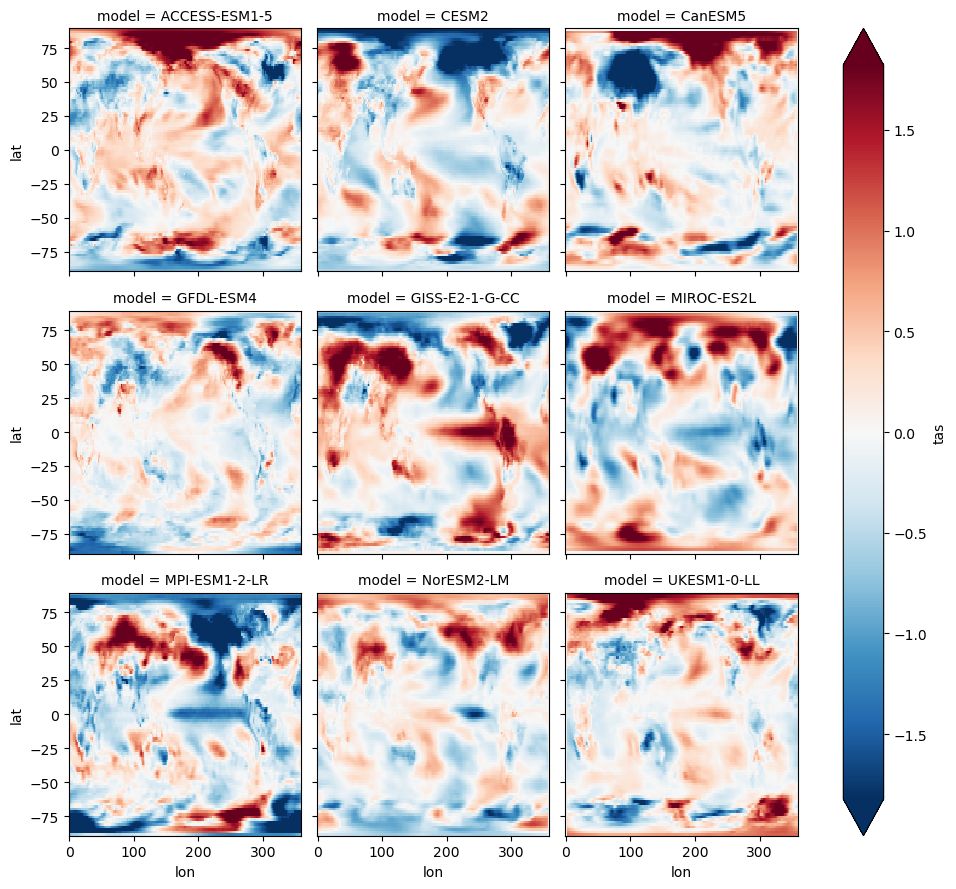

In [55]:
a1_anom_ds.isel(time=0).plot(x='lon', y='lat', col='model', col_wrap=3, robust=True)

In [57]:
# Note: Averaging_period=NOne just means the window gets used.
stable_anom_da = sn.get_stabel_average_anomaly_over_windows(a1_anom_ds.transpose(*['time', 'model', 'lat', 'lon']), rolling_year_stable_local.time,
                                                           averaging_period=None).compute()
stable_anom_da

<function get_stable_average_anomaly_lat_lon at 0x153042ef24d0>


<xarray.DataArray 'temp' (window: 2, model: 9, lat: 96, lon: 192)>
-0.2507 -0.251 -0.2514 -0.2516 -0.2517 -0.2515 ... 3.651 3.661 3.676 3.692 3.396
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * model     (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * window    (window) int64 20 40
    ensemble  <U8 'r1i1p1f1'
    variable  <U15 'signal_to_noise'

In [58]:
gradient_da = stable_anom_da/(rolling_year_stable_local.time.squeeze()+1)
gradient_da = xr.where(gradient_da==np.inf, 0, gradient_da)

In [59]:
#The goal here is to convert all of the unstable points into nan values. So when the count function is used, only the finite values get counted, 
# and we get the percent of points that are stable
stable_sn_da = sn.remove_all_unstable_points(
    sn_multi_rolling_ds.transpose(*['window', 'time', 'model', 'lat', 'lon']).signal_to_noise.isel(time=slice(0,51)).squeeze(),                                           rolling_year_stable_local.time.squeeze())
# stable_sn_da = stable_sn_da.isel(time=slice(0, 50))
stable_sn_da

20
40


<xarray.DataArray 'signal_to_noise' (window: 2, time: 51, model: 9, lat: 96,
                                     lon: 192)>
nan nan nan nan nan nan nan ... 0.8079 0.8162 0.8235 0.8306 0.8404 0.8541 0.8678
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * model     (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * time      (time) object 0001-12-31 00:00:00 ... 0051-12-31 00:00:00
  * window    (window) int64 20 40
    ensemble  <U8 'r1i1p1f1'

In [60]:
# stable_anom_da = stable_anom_da.sortby('model')
# stable_anom_da = stable_anom_da.compute()

# Experimental

In [135]:
from typing import NamedTuple
from enum import Enum

In [136]:
class Region(NamedTuple):
    name: str
    slice: tuple

class regionLatLonTuples(Enum):
    GLOBAL = Region('global', slice(None, None))
    LAND = Region('land', slice(None, None))
    OCEAN = Region('ocean', slice(None, None))
    NH = Region('nh', slice(0, None))
    SH = Region('sh', slice(None, 0))
    TROPICS = Region('tropics', slice(-23, 23))
    MID_LAT_SH = Region('mid_lat_sh', slice(-66, -23))
    MID_LAT_NH = Region('mid_lat_nh', slice(23, 66))
    ARCTIC = Region('arctic', slice(66, None))
    ANTARCTIC = Region('antarctic', slice(None, -66))


NAMING_MAP = {
    'global': 'Global',
    'nh': 'Northern Hemisphere',
    'sh': 'Southern Hemisphere',
    'tropics': 'Tropics',
    'land': 'Land',
    'ocean': 'Ocean',
    'mid_lat_nh': 'Mid Latitudes NH',
    'mid_lat_sh': 'Mid Latitudes SH',
    'arctic': 'Arctic',
    'antarctic': 'Antarctic'}

In [181]:
def create_regions(binary_emergence_ds: xr.Dataset, land_mask_ds:xr.Dataset) -> xr.Dataset:
    """
    Calculate the percentage of stability for regions based on binary emergence data.

    Parameters:
        binary_emergence_ds (xr.Dataset): Dataset containing binary emergence data.
        land_mask_ds (xr.Dataset): Dataset containing land mask data.
        only_1s_ds (xr.Dataset): Dataset with only values of 1. This is needed as it can differ
                                due to data availability

    Returns:
        xr.Dataset: Dataset with percentage of stability for each region.

    This function calculates the percentage of stability for regions based on binary
    emergence data and land mask information. It assumes the existence of a variable
    'only_1s_ds' that is the same shape as 'binary_emergence_ds' and contains only
    values of 1 where the event has occurred.
    """

    # Calculating the weights
    weights = np.cos(np.deg2rad(binary_emergence_ds.lat))
    weights.name = 'weights'

    # The two regions that need the land-sea make
    NEEDS_MASKING = ['land', 'ocean']

    ds_collection = [] # Storing all the datasets
    points_in_region_dict = {} # The number of 
    for region in regionLatLonTuples:
        region_name = region.value.name.lower()
        lat_slice = region.value.slice
        
        # Select data for the current region
        ds_region = binary_emergence_ds.sel(lat=lat_slice).expand_dims({'region':[region_name]})

        # Apply masking if needed
        if region_name in NEEDS_MASKING:
            mask_to_use_ds = xr.where(land_mask_ds, 1, 0) if region_name == 'land' else xr.where(land_mask_ds, 0, 1) 
            ds_region = ds_region.where(mask_to_use_ds)


        ds_collection.append(ds_region)

    ds_regions = xr.concat(ds_collection, dim='region')

    return ds_regions

## Regional Averages

In [208]:
a1_anom_regions_ds = create_regions(a1_anom_ds.squeeze(), mask_ds.mask)

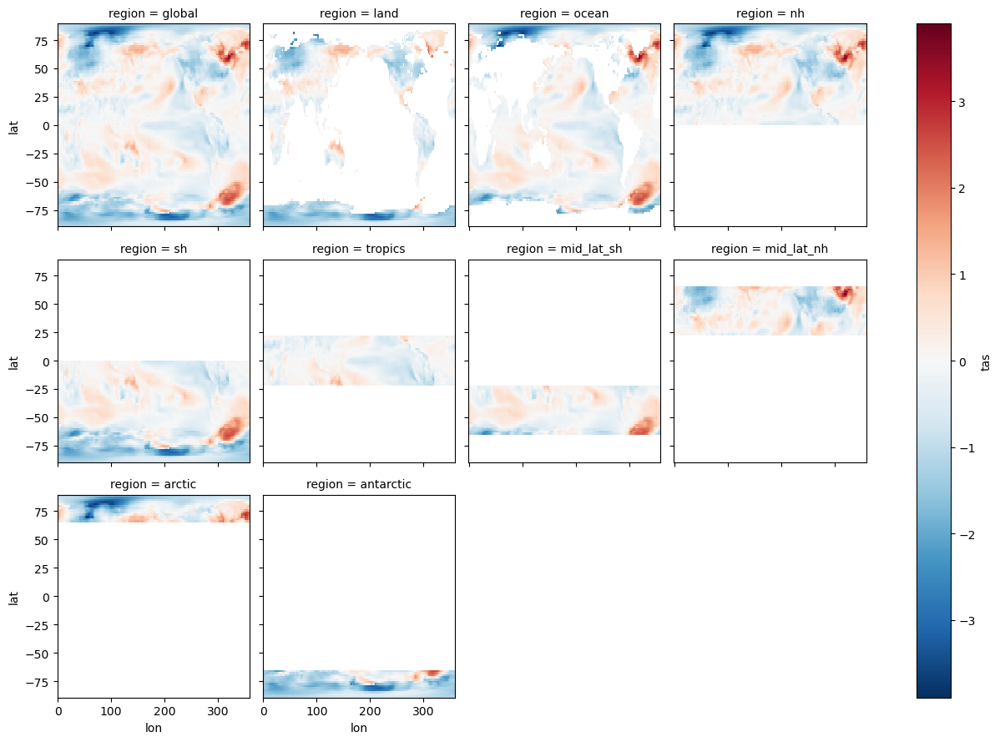

In [217]:
a1_anom_regions_ds.isel(time=10, model=0).plot(col='region', col_wrap=4)

In [222]:
esmpi_regions_ds = create_regions(esmpi_ds.squeeze(), mask_ds.mask)

In [ ]:
a1_anom_regions_smean_ds = sn.calculate_global_value(a1_anom_regions_ds, 'tas')

In [224]:
esmpi_regions_smean_ds = sn.calculate_global_value(esmpi_regions_ds, 'tas')

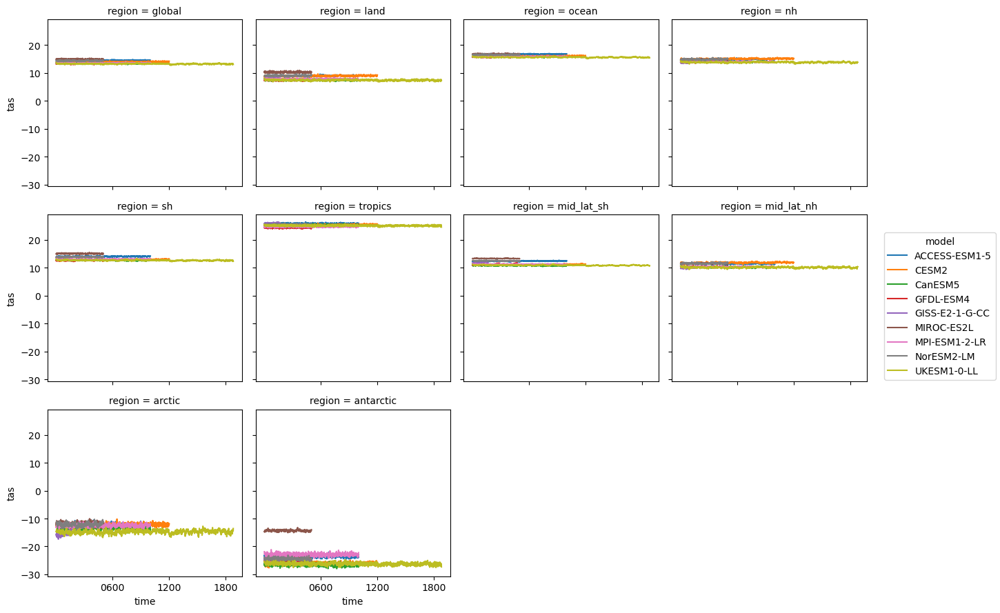

In [225]:
esmpi_regions_smean_ds.plot(col='region', col_wrap=4, hue='model', x='time')

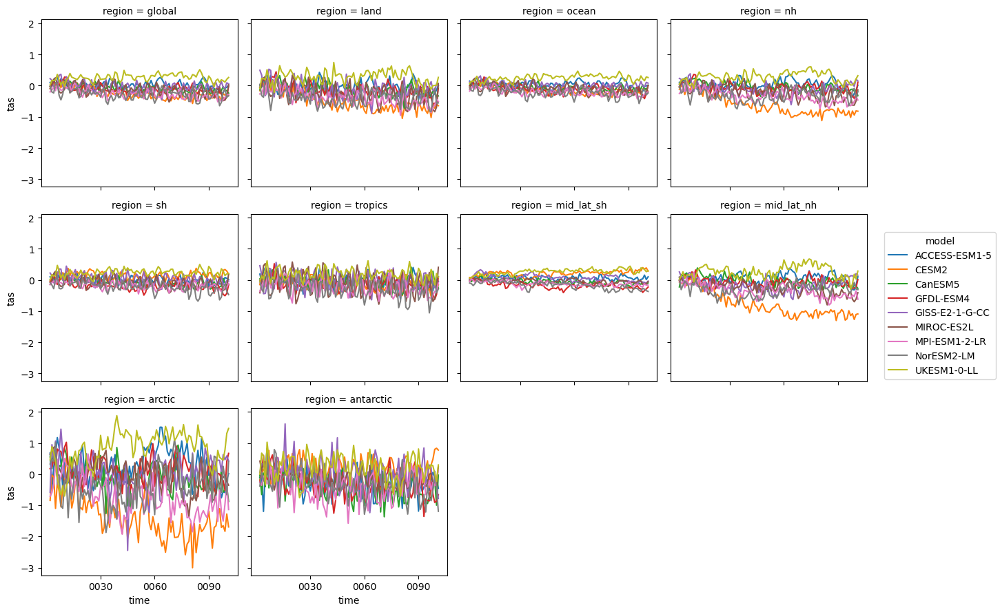

In [223]:
a1_anom_regions_smean_ds.plot(col='region', col_wrap=4, hue='model', x='time')

In [218]:
REGION_RUN_PARAMS = {'windows': [20, 40]}

{'start_window': 10, 'end_window': 41, 'step_window': 1}

In [219]:
# Params to use for both
SN_PARAMS = dict(return_all=True, center=True, return_control=True, logginglevel='ERROR')

In [227]:
a1_smean_anom_trend_region_ds = stats.trend_fit(a1_anom_regions_smean_ds, method='polynomial', order=3)

In [230]:
a1_smean_anom_detrend_region_ds = a1_anom_regions_smean_ds - a1_smean_anom_trend_region_ds

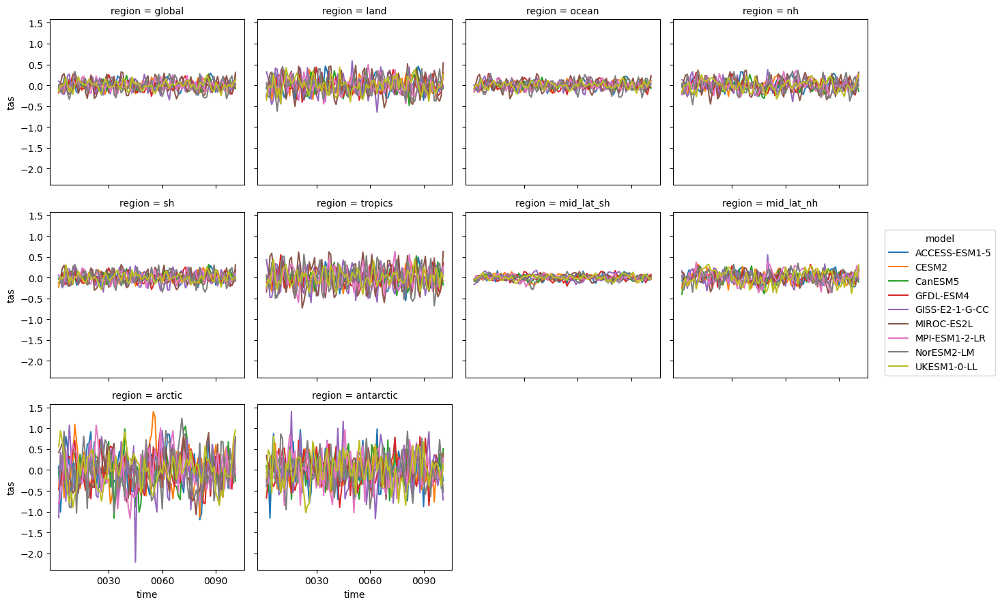

In [231]:
a1_smean_anom_detrend_region_ds.plot(col='region', col_wrap=4, hue='model', x='time')

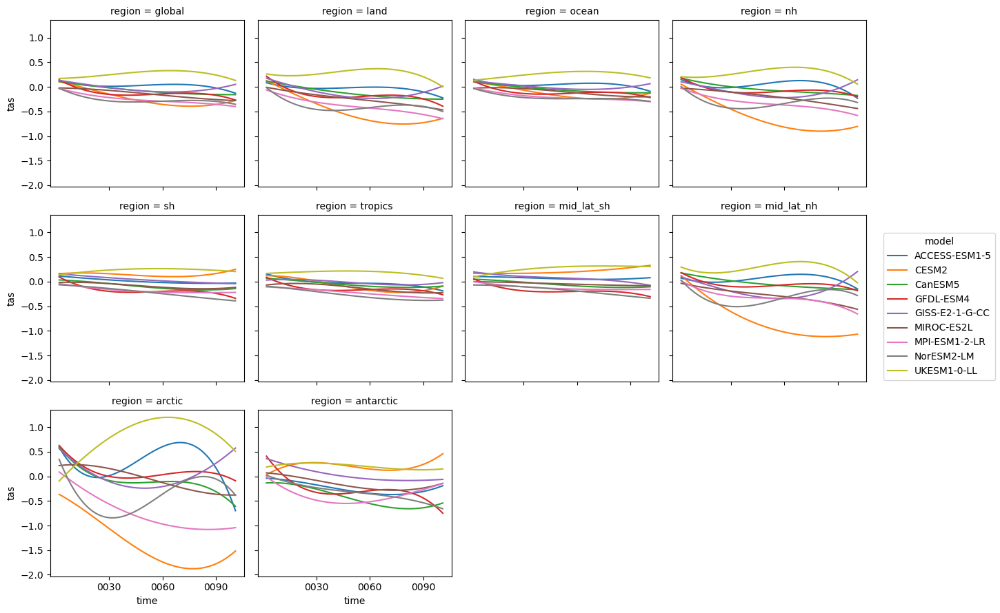

In [229]:
a1_smean_anom_trend_region_ds.plot(col='region', col_wrap=4, hue='model', x='time')

In [232]:
sn_multi_rolling_smean_region_ds, sn_multi_rolling_control_smean_region_ds = sn.multiwindow_signal_to_nosie_and_bounds(
    a1_anom_regions_smean_ds, esmpi_regions_smean_ds, da_for_noise = a1_smean_anom_detrend_region_ds,
    rolling_noise=True, lower_bound=5, upper_bound=95, windows = [20, 40],  **SN_PARAMS)


Experiment
--------
20, 40, 
Concatenating objects - PLEASE be patient!
 - Finished

Control
------

20, 40, 
Concatenating objects - PLEASE be patient!
Persist
Calculating bounds
final merge


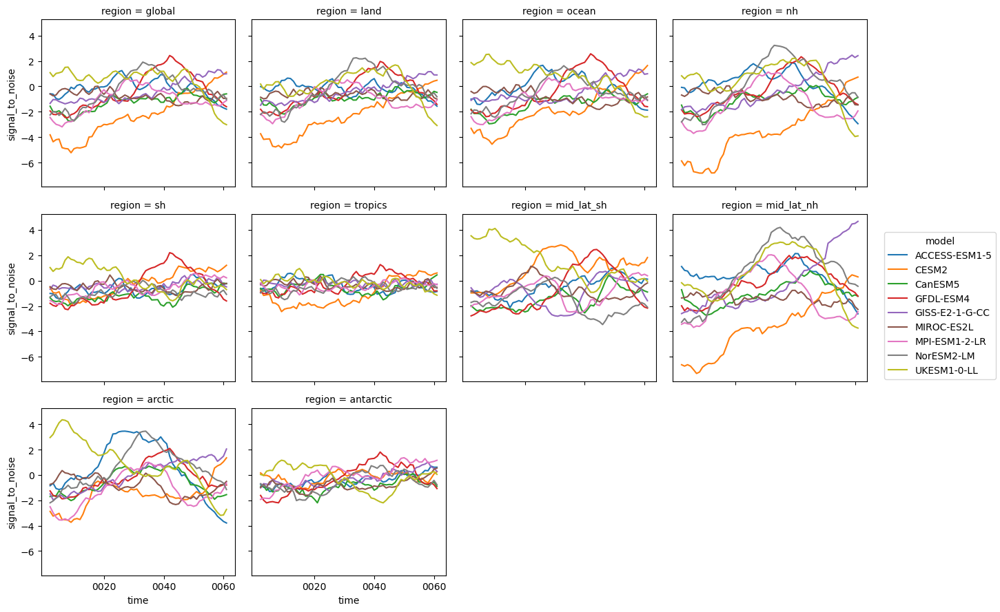

In [235]:
sn_multi_rolling_smean_region_ds.signal_to_noise.sel(window=40).plot(col='region', col_wrap=4, hue='model', x='time')

In [241]:
year_stable_smean_region_ds = sn.get_stable_year_ds(sn_multi_rolling_smean_region_ds, max_effective_length=60).squeeze()

In [245]:
year_stable_smean_region_ds

<xarray.Dataset>
Dimensions:   (model: 9, region: 10, window: 2)
Coordinates:
  * model     (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * region    (region) object 'global' 'land' 'ocean' ... 'arctic' 'antarctic'
  * window    (window) int64 20 40
    ensemble  <U8 'r1i1p1f1'
    variable  <U15 'signal_to_noise'
Data variables:
    time      (window, region, model) int64 0 28 9 8 15 0 16 ... 0 35 0 12 25 0

In [250]:
import seaborn as sns

In [260]:
year_stable_smean_region_dataframe = year_stable_smean_region_ds.sel(window=40).time.to_pandas()

<Axes: xlabel='region'>

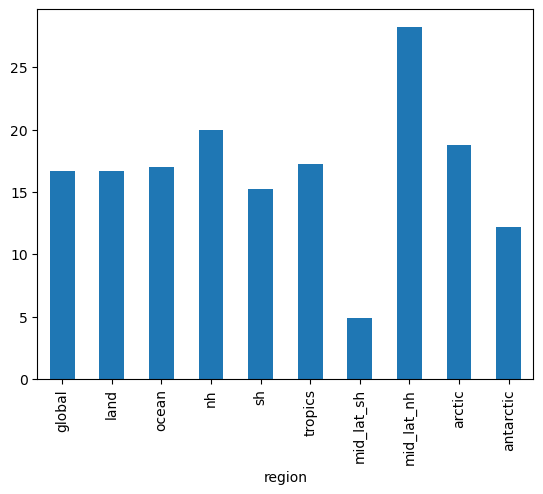

In [265]:
year_stable_smean_region_dataframe.mean(axis=1).plot.bar()

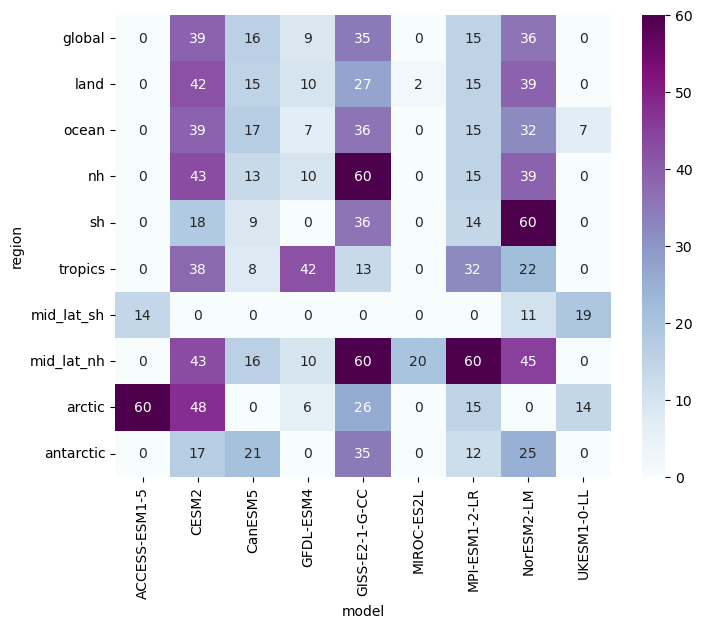

In [267]:
plt.figure(figsize=(8, 6))
heatmap = sns.heatmap(year_stable_smean_region_dataframe.astype(int), annot=True, cmap='BuPu')

# # Change the ticks to long names
# heatmap.set_xticklabels([toe_const.NAME_CONVERSION_DICT[text.get_text()] for text in heatmap.get_xticklabels()])
# heatmap.set_yticklabels([toe_const.NAME_CONVERSION_DICT[text.get_text()] for text in heatmap.get_yticklabels()])

# plt.title('Pattern Correlations');
# plt.xticks(rotation=45);  # Rotate x-axis labels for better readability
# plt.yticks(rotation=0) ;

In [249]:
year_stable_smean_region_ds.sel(window=40)

<xarray.Dataset>
Dimensions:   (model: 9, region: 10)
Coordinates:
  * model     (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * region    (region) object 'global' 'land' 'ocean' ... 'arctic' 'antarctic'
    window    int64 40
    ensemble  <U8 'r1i1p1f1'
    variable  <U15 'signal_to_noise'
Data variables:
    time      (region, model) int64 0 39 16 9 35 0 15 36 ... 21 0 35 0 12 25 0

## Individual Grid Cells

In [ ]:
rolling_year_stable_local_regions = create_regions(rolling_year_stable_local.squeeze(), mask_ds.mask)

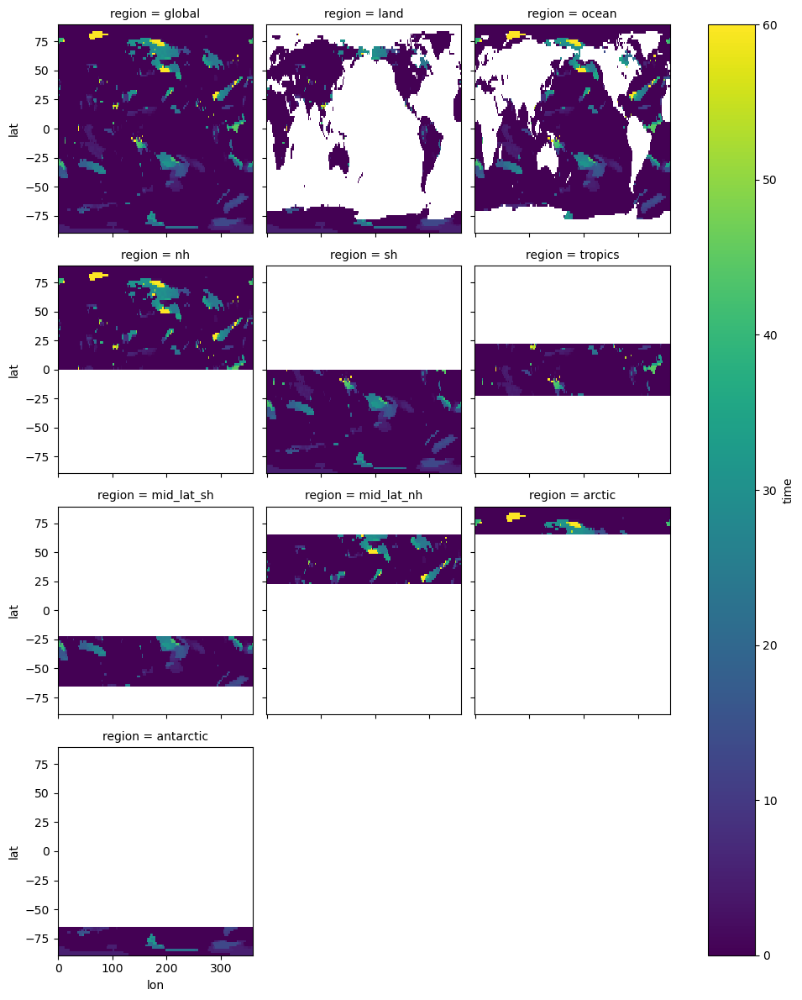

In [185]:
rolling_year_stable_local_regions.isel(model=0, window=1).time.plot(col='region', col_wrap=3)

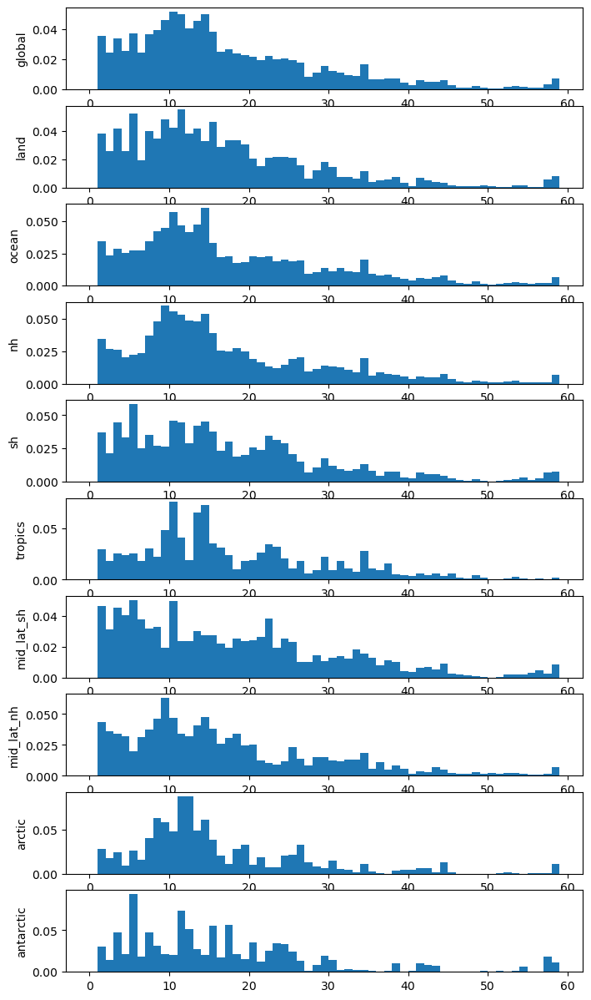

In [205]:
window = 40
regions = rolling_year_stable_local_regions.region.values

fig = plt.figure(figsize=(8, 15))
axes = [fig.add_subplot(len(regions), 1, i+1) for i in range(len(regions))]
for num,region in enumerate(regions):

    ax = axes[num]
    arr = rolling_year_stable_local_regions.sel(region=region, window=window).time.values.flatten()
    arr = arr[np.isfinite(arr)]
    arr = arr[arr>0]
    ax.hist(arr, bins=np.arange(0, 60, 1), density=True)
    ax.set_ylabel(region)

# Fractional (Percentage) Time series

In [61]:
def fraction_comparison(ds_num, ds_denom, weights):
    """
    Calculate the percentage by comparing two datasets.

    Parameters:
        ds_num (xarray.Dataset): Numerator dataset.
        ds_denom (xarray.Dataset): Denominator dataset.
        weights (xarray.DataArray): Weights for the calculation.

    Returns:
        xarray.DataArray: Dataset containing the percentage.
    """
    # Calculate the sum of the numerator dataset weighted by weights
    ds_num_sum = ds_num.weighted(weights).sum(dim=['lat', 'lon'])

    # Calculate the sum of the denominator dataset weighted by weights
    ds_denom_sum = ds_denom.weighted(weights).sum(dim=['lat', 'lon'])

    # Calculate the percentage
    percent_ds = ds_num_sum / ds_denom_sum * 100

    return percent_ds

In [62]:
def calculate_percent_stable_all_regions(binary_ds: xr.Dataset, weights: xr.Dataset, full_ds: xr.Dataset, mask_ds: xr.Dataset) -> xr.Dataset:
    """
    Calculate percentages of stability for different regions.

    Parameters:
        binary_ds (xarray.Dataset): Binary dataset with stability information.
        weights (xarray.Dataset): Weights to be applied for calculation.
        full_ds (xarray.Dataset): Full dataset for comparison.
        mask_ds (xarray.Dataset): Dataset with mask information.

    Returns:
        xarray.Dataset: Dataset containing percentages of stability for various regions.
    """
    # Calculate global stability percentage
    global_percent_ds = fraction_comparison(binary_ds, full_ds, weights).expand_dims('region').assign_coords(region=['gl'])

    # Calculate land-only stability percentage
    land_percent_ds = fraction_comparison(binary_ds.where(mask_ds.mask), full_ds.where(mask_ds.mask), weights).expand_dims('region').assign_coords(region=['land'])

    # Calculate ocean stability percentage
    ocean_percent_ds = fraction_comparison(binary_ds.where(mask_ds.mask == 0), full_ds.where(mask_ds.mask == 0), weights).expand_dims('region').assign_coords(region=['ocean'])

    # Calculate Northern Hemisphere stability percentage
    nh_percent_ds = fraction_comparison(binary_ds.sel(lat=slice(0, None)), full_ds.sel(lat=slice(0, None)), weights).expand_dims('region').assign_coords(region=['nh'])

    # Calculate Southern Hemisphere stability percentage
    sh_percent_ds = fraction_comparison(binary_ds.sel(lat=slice(None, 0)), full_ds.sel(lat=slice(None, 0)), weights).expand_dims('region').assign_coords(region=['sh'])

    # Calculate Tropics stability percentage
    tropics_percent_ds = fraction_comparison(binary_ds.sel(lat=slice(-23, 23)), full_ds.sel(lat=slice(-23, 23)), weights).expand_dims('region').assign_coords(region=['tropics'])

    # Calculate Mid-Latitude Southern Hemisphere stability percentage
    mid_lat_sh_percent_ds = fraction_comparison(binary_ds.sel(lat=slice(-66, -23)), full_ds.sel(lat=slice(-66, -23)), weights).expand_dims('region').assign_coords(region=['mid_sh'])

    # Calculate Mid-Latitude Northern Hemisphere stability percentage
    mid_lt_nh_percent_ds = fraction_comparison(binary_ds.sel(lat=slice(23, 66)), full_ds.sel(lat=slice(23, 66)), weights).expand_dims('region').assign_coords(region=['mid_nh'])

    # Calculate Antarctic stability percentage
    antarctic_ds = fraction_comparison(binary_ds.sel(lat=slice(None, -66)), full_ds.sel(lat=slice(None, -66)), weights).expand_dims('region').assign_coords(region=['antarctic'])

    # Calculate Arctic stability percentage
    arctic_ds = fraction_comparison(binary_ds.sel(lat=slice(66, None)), full_ds.sel(lat=slice(66, None)), weights).expand_dims('region').assign_coords(region=['arctic'])

    # Concatenate all region datasets
    all_region_ds = xr.concat([global_percent_ds, nh_percent_ds, sh_percent_ds, land_percent_ds, ocean_percent_ds, 
                               arctic_ds, antarctic_ds, mid_lt_nh_percent_ds, mid_lat_sh_percent_ds, tropics_percent_ds ], dim='region')

    all_region_ds.name = 'percent_stable'
    return all_region_ds

In [63]:
# Calculating the weights
weights = np.cos(np.deg2rad(mask_ds.lat))
weights.name = 'weights'

In [64]:
# A dataset with every point as 1, this is useful for getting the maximum weighted sum for a field
full_ds =  xr.where(np.isfinite(stable_sn_da), 1, 1)

In [65]:
# Where the values are stable replace with 1, otherwise replace with 0
binary_ds = xr.where(np.isfinite(stable_sn_da), 1, 0)

In [66]:
# The percent of points that are stable each each timestep
percent_stable_timeseries_ds = calculate_percent_stable_all_regions(binary_ds, weights, full_ds, mask_ds)

percent_stable_timeseries_ds = percent_stable_timeseries_ds.compute()

In [67]:
percent_stable_timeseries_ds

<xarray.DataArray 'percent_stable' (region: 10, window: 2, time: 51, model: 9)>
78.51 69.83 77.62 69.55 69.14 85.17 88.83 ... 98.3 96.65 99.07 99.66 99.24 99.48
Coordinates:
  * model     (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
  * time      (time) object 0001-12-31 00:00:00 ... 0051-12-31 00:00:00
  * window    (window) int64 20 40
    ensemble  <U8 'r1i1p1f1'
  * region    (region) <U9 'gl' 'nh' 'sh' 'land' ... 'mid_nh' 'mid_sh' 'tropics'

In [68]:
# Sperating into cooling and warming trends.

# Which temperature to use?
# - Currently is done with the temperature anomaly at stabilisation (not a time series)
# - However, I think it should be done with the signal time series instead (positive signal is warming [same as temperature amomly essentially]

# How is the fraction done?
# - Fractin of the warming trends that are warming or cooling
# - Fraction of all (global) trends that are warming or cooling

In [69]:
### New
# Fraction of global points AND signal time series

# binary_warm_ds = binary_ds.where(sn_multi_rolling_ds.signal>0)
# binary_cool_ds = binary_ds.where(sn_multi_rolling_ds.signal<=0)

# full_warms_ds = full_ds.where(sn_multi_rolling_ds.signal>0)
# full_cool_ds = full_ds.where(stable_anom_da<=0)

# fraction_warm_ds = fraction_comparison(binary_warm_ds, full_ds, weights).expand_dims(region=['global_warm']) #full_warms_ds
# fraction_cool_ds = fraction_comparison(binary_cool_ds, full_ds, weights).expand_dims(region=['global_cool']) #full_cool_ds

In [70]:
# Opposite of the above: Stable replace with 0n and unstable is 1.
# The opposite is need as we are looking at when the percetage of unstable points becomes 0
binary_unstable_ds = xr.where(np.isfinite(stable_sn_da), 0, 1)
binary_unstable_warm_ds = binary_unstable_ds.where(sn_multi_rolling_ds.signal>0)
binary_unstable_cool_ds = binary_unstable_ds.where(sn_multi_rolling_ds.signal<=0)

In [71]:
number_warm_ds = fraction_comparison(binary_unstable_warm_ds, full_ds, weights).expand_dims(region=['global_warm']) 
#binary_unstable_warm_ds.sum(dim=['lat', 'lon'])
number_cool_ds = fraction_comparison(binary_unstable_cool_ds, full_ds, weights).expand_dims(region=['global_warm']) 
#binary_unstable_cool_ds.sum(dim=['lat', 'lon'])

In [72]:
### OLD
# Fraction of warming trends AND tempeature anomly at stabilisation

# binary_warm_ds = binary_ds.where(stable_anom_da>0)
# full_warms_ds = full_ds.where(stable_anom_da>0)

# binary_cool_ds = binary_ds.where(stable_anom_da<=0)
# full_cool_ds = full_ds.where(stable_anom_da<=0)

# fraction_warm_ds = fraction_comparison(binary_warm_ds,full_warms_ds , weights).expand_dims(region=['global_warm'])

# fraction_cool_ds = fraction_comparison(binary_cool_ds, full_cool_ds, weights).expand_dims(region=['global_cool'])

In [73]:
# Too clutered when adding in the cooling and warmign trend averages
percent_stable_timeseries_average_ds = percent_stable_timeseries_ds.median(dim='model')
# THe average: This is also needed so the warm and cool trends can go in. 

# percent_stable_timeseries_average_ds = xr.concat([
#     percent_stable_timeseries_ds.median(dim='model'),
#     fraction_warm_ds.median(dim='model'),
#     fraction_cool_ds.median(dim='model')], dim='region')

percent_stable_timeseries_average_ds

<xarray.DataArray 'percent_stable' (region: 10, window: 2, time: 51)>
78.51 79.98 81.51 84.56 85.55 85.92 ... 99.04 99.04 99.11 99.11 99.24 99.24
Coordinates:
  * time      (time) object 0001-12-31 00:00:00 ... 0051-12-31 00:00:00
  * window    (window) int64 20 40
    ensemble  <U8 'r1i1p1f1'
  * region    (region) <U9 'gl' 'nh' 'sh' 'land' ... 'mid_nh' 'mid_sh' 'tropics'

## Plotting

In [74]:
experiment_params = constants.EXPERIMENTS_TO_RUN[0]
experiment_params

{'variable': 'tas', 'mask': None, 'hemisphere': 'global'}

In [75]:
units = constants.VARIABLE_INFO[experiment_params["variable"]]["units"]
longname = constants.VARIABLE_INFO[experiment_params["variable"]]['longname']
hemisphere_title = string.capwords(experiment_params['hemisphere'].replace('_', ' '))
mask_title = f'({experiment_params["mask"]} only)' if experiment_params["mask"] else ''

### Percent of Year Stable

In [76]:
NAMING_MAP = {'gl': 'Global',
 'nh': 'Northern Hemisphere',
 'sh': 'Southern Hemisphere',
 'tropics': 'Tropics',
 'land': 'Land',
 'ocean': 'Ocean',
 'mid_nh': 'Mid Latitudes NH',
 'mid_sh': 'Mid Latitudes SH',
 'arctic': 'Arctic',
 'antarctic': 'Antarctic',
 'global_warm': 'Warming Trends',
 'global_cool': 'Cooling Trends'}

In [77]:
linestyles = ['--', '-'] * int(np.ceil(len(percent_stable_timeseries_ds.model.values)/2))
linestyles

['--', '-', '--', '-', '--', '-', '--', '-', '--', '-']

In [78]:
# linestyle_dict = {'ACCESS-ESM1-5': '--','CESM2': '-','CanESM5': '--','GFDL-ESM4': '-','GISS-E2-1-G-CC': '--',
#                   'MIROC-ES2L': '-','MPI-ESM1-2-LR': '--','NorESM2-LM': '-','UKESM1-0-LL': '--'}

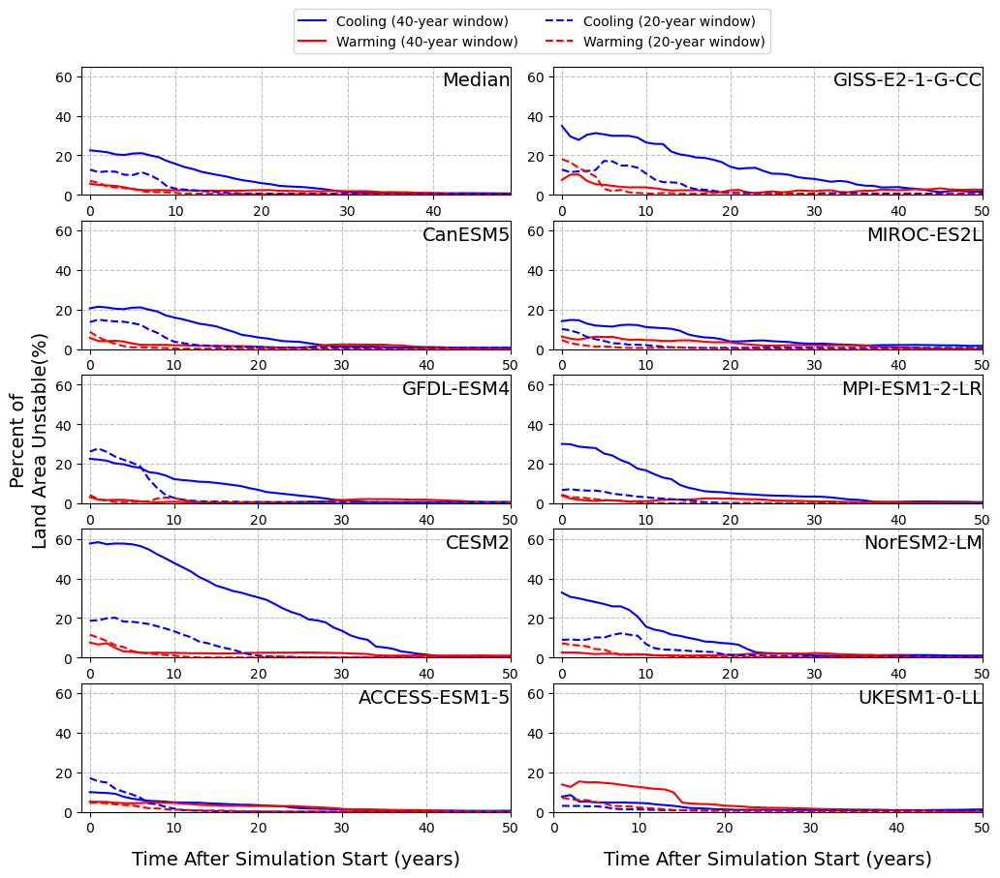

In [79]:
ncols = 2
nrows = int(np.ceil(len(constants.ZECMIP_MODEL_PARAMS)/ncols))

fig = plt.figure(figsize=(6*ncols, 2*nrows))
gs = gridspec.GridSpec(nrows, ncols, hspace=.2, wspace=.1)
axes = [fig.add_subplot(gs[i]) for i in range(10)]


time = number_cool_ds.time.dt.year.values

for num, model in enumerate(constants.ZECMIP_MODEL_PARAMS):

    ax = axes[num+1]
    ax.plot(time, number_cool_ds.sel(window=40, model=model).squeeze().values, color='blue', label='Cooling (40-year window)')
    ax.plot(time, number_warm_ds.sel(window=40, model=model).squeeze().values, color='red', label='Warming (40-year window)')
    
    ax.plot(time, number_cool_ds.sel(window=20, model=model).squeeze().values, linestyle='--', color='blue', label='Cooling (20-year window)')
    ax.plot(time, number_warm_ds.sel(window=20, model=model).squeeze().values, linestyle='--', color='red', label='Warming (20-year window)')

    ax.annotate(model, xy=(1, 0.85), fontsize=14, xycoords='axes fraction', ha='right')
    
    sn_plotting.format_xticks(axes[num], time, time-1)

    ax.grid(True, alpha=0.5, c='grey', linestyle='--')
    ax.set_xlim(0, 50)
    
    ax.set_ylim(0, 65)    
    # ax.set_ylim(40, 105)
    if num==3: ax.set_ylabel('Percent of\nLand Area Unstable(%)', fontsize=14)


ax = axes[0]
ax.plot(time, number_cool_ds.sel(window=40).median(dim='model').squeeze().values, color='blue', label='Cooling (40-year window)')
ax.plot(time, number_warm_ds.sel(window=40).median(dim='model').squeeze().values, color='red', label='Warming (40-year window)')

ax.plot(time, number_cool_ds.sel(window=20).median(dim='model').squeeze().values, linestyle='--', color='blue', label='Cooling (20-year window)')
ax.plot(time, number_warm_ds.sel(window=20).median(dim='model').squeeze().values, linestyle='--', color='red', label='Warming (20-year window)')

ax.annotate('Median', xy=(1, 0.85), ha='right', fontsize=14, xycoords='axes fraction')
sn_plotting.format_xticks(axes[num], time, time-1)

ax.grid(True, alpha=0.5, c='grey', linestyle='--')
ax.set_xlim(0, 50)
# ax.set_ylim(40, 105)    
ax.set_ylim(0, 65)    

# Place the legend at the center just above the first row of plots
# Adjust the bbox_to_anchor values to center the legend
leg = axes[1].legend(ncol=2, bbox_to_anchor=[-0.05, 1.5], loc='upper center', fontsize=10)
axes[-1].set_xlabel('Time After Simulation Start (years)', va='bottom', fontsize=14, labelpad=25);
axes[-2].set_xlabel('Time After Simulation Start (years)', va='bottom', fontsize=14, labelpad=25);

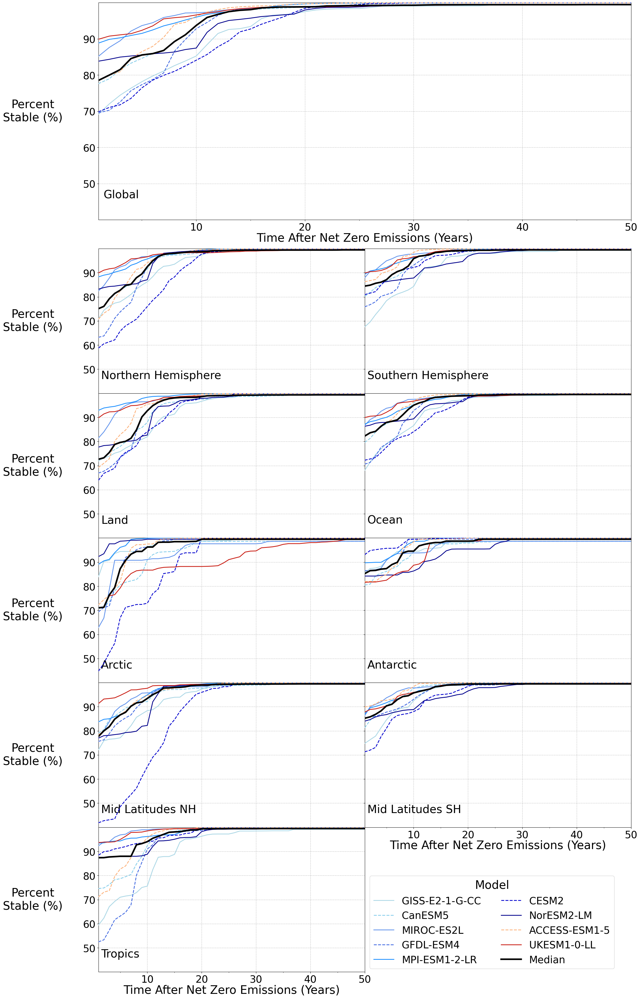

In [80]:
### Plot set-up

line_plot_kwargs = dict(xlabel='Time After Net Zero Emissions (Years)', labelpad=70, ncol=2, exp_type='zecmip', font_scale=1.8,
                        xlim=(0, 49), bbox_to_anchor=(1, 0.7))
left_kwargs = dict(ylabel='Percent\nStable (%)')

window = 20

line_plot_kwargs['ylim'] = (0, 100) if window == 40 else (40, 100)

### Plot Creation
nplots = len(percent_stable_timeseries_ds.region.values)+1
fig = plt.figure(figsize=(12*2, 4*nplots))
gs = gridspec.GridSpec(int(np.ceil(nplots/2))+1, 2, height_ratios=[1.5]+[0.2] + [1]*int(np.ceil((nplots-2)/2)), wspace=0, hspace=0)
ax0 = fig.add_subplot(gs[0, :]); axes = [fig.add_subplot(gs[i+4]) for i in range(nplots-2)]
axes.insert(0, ax0)

for num, reg in enumerate(percent_stable_timeseries_ds.region.values):
    kwargs_to_use = left_kwargs if ((num%2) or (num==0)) else {}
    sn_plotting.plot_all_coord_lines(percent_stable_timeseries_ds.sel(region=reg, window=window), fig=fig, ax=axes[num],
                                     title=NAMING_MAP[reg], #linestyle=linestyle_dict, 
                                     add_legend=False if num < len(percent_stable_timeseries_ds.region.values)-1 else True,
                                     logginglevel='ERROR',
                                     **kwargs_to_use, **line_plot_kwargs);

for num, ax in enumerate(axes):
    title = ax.get_title()
    ax.set_title('')
    # Remove the first and last yticks so it doesn't overlap with the next/previous plot.
    ax.set_yticks(np.take(ax.get_yticks(), np.arange(1, len(ax.get_yticks())-1)))
    ax.annotate(title, xy=(0.01, 0.1), xycoords='axes fraction', size=constants.PlotConfig.title_size*1.4)
    if not num%2 and num >1: ax.set_yticklabels([])
    if 1 < num < 8: ax.set_xticklabels([]) # Need or the last number can still be seen

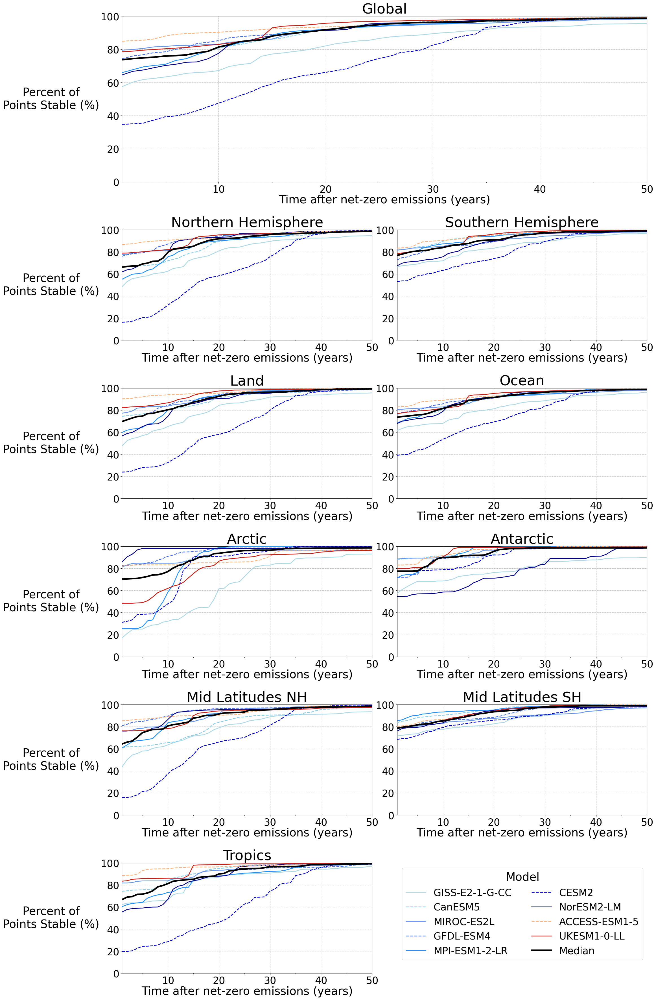

In [81]:

line_plot_kwargs = dict(xlabel='Time after net-zero emissions (years)', labelpad=70, ncol=2, exp_type='zecmip', font_scale=1.8,
                        xlim=(0, 49), ylim=(0, 100), bbox_to_anchor=(1.1,1))
left_kwargs = dict( ylabel='Percent of\nPoints Stable (%)')

window = 40
plt.style.use('default')
nplots = len(percent_stable_timeseries_ds.region.values)+1
fig = plt.figure(figsize=(12*2, 4*nplots))
gs = gridspec.GridSpec(int(np.ceil(nplots/2)), 2, height_ratios=[1.5] + [1]*int(np.ceil((nplots-2)/2)), wspace=0.1, hspace=0.4)
ax0 = fig.add_subplot(gs[0, :]); axes = [fig.add_subplot(gs[i+2]) for i in range(nplots-2)]
axes.insert(0, ax0)

for num, reg in enumerate(percent_stable_timeseries_ds.region.values):
    kwargs_to_use = left_kwargs if ((num%2) or (num==0)) else {}
    sn_plotting.plot_all_coord_lines(percent_stable_timeseries_ds.sel(region=reg,window=window), fig=fig, ax=axes[num],
                                     title=NAMING_MAP[reg],add_legend=False if num < len(percent_stable_timeseries_ds.region.values)-1 else True, liensytle=linestyles,
                                     **kwargs_to_use, **line_plot_kwargs);
    #axes[num].set_xlim([stable_sn_da.time.values[0], stable_sn_da.time.values[-1]]); axes[num].set_ylim(0, 100)

In [82]:
# style_dict = {'gl':{'color':'black', 'linewidth':5, 'zorder':100},
#               'land':{'color':'brown', 'linestyle':'--'}, 'ocean':{'color':'blue', 'linestyle':'--'},
#               'nh':{'color':'m', 'linestyle':(0, (1,1))}, 'sh':{'color':'orange', 'linestyle':(0, (1,1))},
#               'tropics':{'color':'darkgreen'}, 'mid_nh':{'color':'red'}, 'mid_sh':{'color':'tomato'},
#               'arctic':{'color':'lightblue'}, 'antarctic':{'color':'darkblue'}}

In [83]:
line_plot_kwargs_median = dict(xlabel='Time after net-zero emissions (years)', ylabel='',
                               labelpad=70, font_scale=1.1,xlim=(0, 49), ylim=(60, 101), consensus=False)

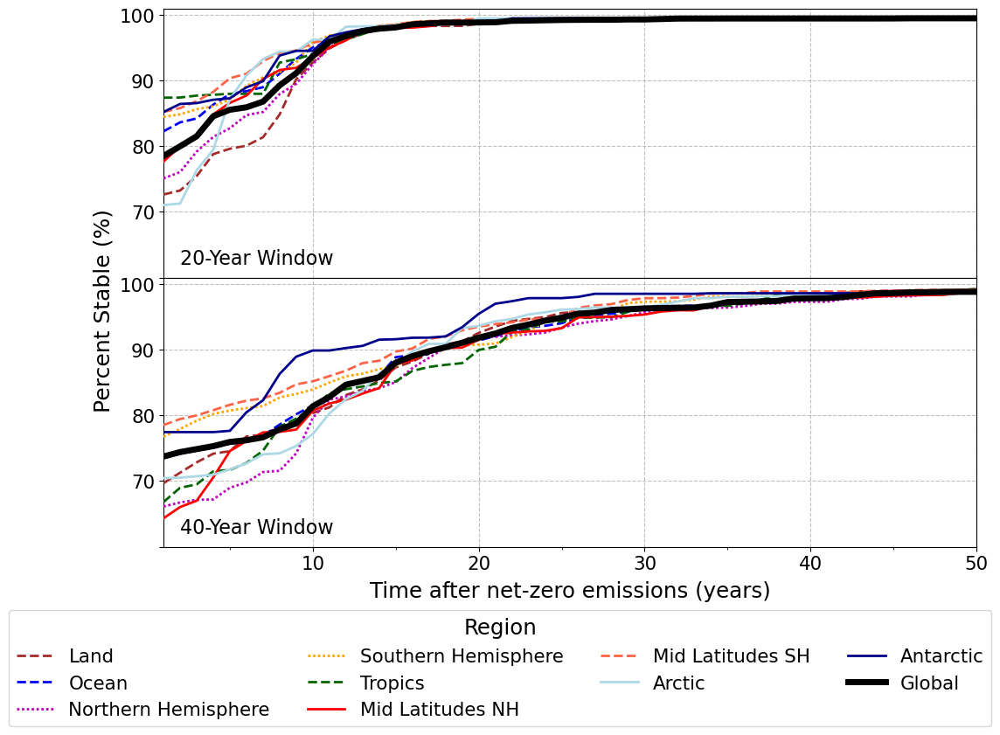

<Figure size 1500x700 with 0 Axes>

<Figure size 1500x700 with 0 Axes>

In [84]:
fig = plt.figure(figsize=(12, 4*2))
gs = gridspec.GridSpec(2, 1, hspace=0)
axes = [fig.add_subplot(gs[i]) for i in range(2)]

sn_plotting.plot_all_coord_lines(percent_stable_timeseries_ds.sel(window=20).median(dim='model'),
                                 ax=axes[0], coord='region', exp_type='region',linestyle=linestyles, 
                                 add_legend=False, **line_plot_kwargs_median)


fig, ax, leg = sn_plotting.plot_all_coord_lines(percent_stable_timeseries_ds.sel(window=40).median(dim='model'),
                                                ax=axes[1], coord='region', exp_type='region', linestyle=linestyles, 
                                                add_legend=True, bbox_to_anchor=(1.03,-0.2), **line_plot_kwargs_median)

ax.set_ylabel('Percent Stable (%)', size=18, ha='left')

# Update the legend elements. Get the legend labels
labels = [text.get_text() for text in leg.get_texts()]
for old_label, new_label in NAMING_MAP.items():
    try:
        leg.get_texts()[labels.index(old_label)].set_text(new_label)
    except ValueError: pass

axes[0].set_xticklabels([])
axes[0].annotate('20-Year Window', xy=(0.02, 0.05), fontsize=16, xycoords='axes fraction')
axes[1].annotate('40-Year Window', xy=(0.02, 0.05), fontsize=16, xycoords='axes fraction')


labels = [l.get_text() for l in axes[1].get_yticklabels()]
labels[0] = ''
axes[0].set_yticklabels(labels);
axes[1].set_yticklabels(labels);

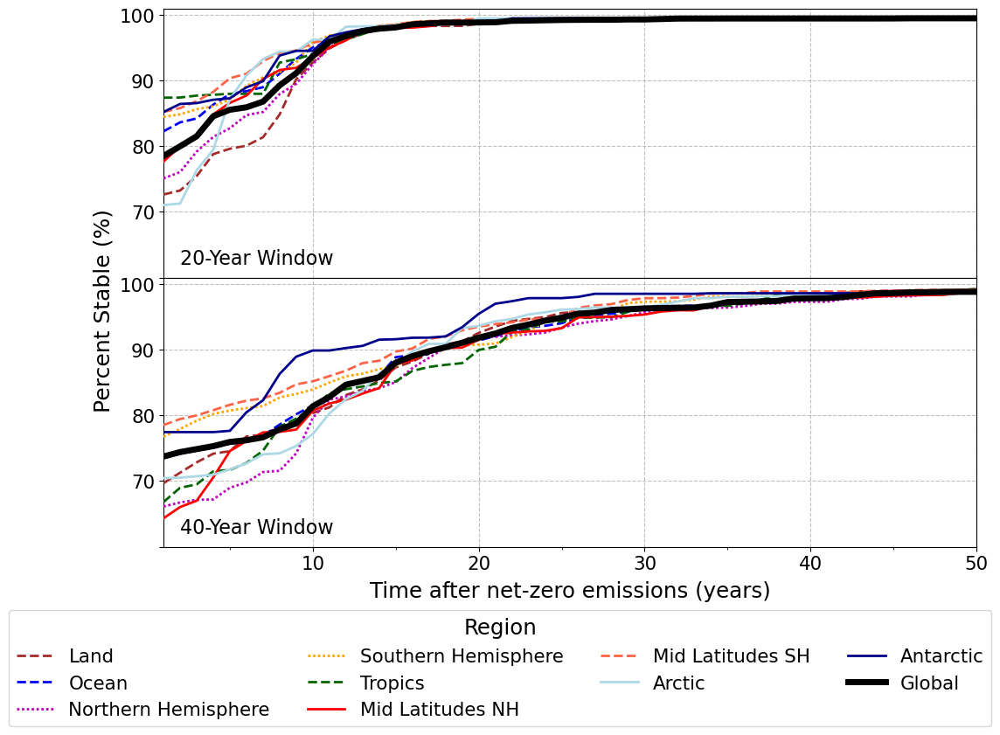

<Figure size 1500x700 with 0 Axes>

<Figure size 1500x700 with 0 Axes>

In [85]:
fig = plt.figure(figsize=(12, 4*2))
gs = gridspec.GridSpec(2, 1, hspace=0)
axes = [fig.add_subplot(gs[i]) for i in range(2)]

sn_plotting.plot_all_coord_lines(percent_stable_timeseries_average_ds.sel(window=20),
                                 ax=axes[0], coord='region', exp_type='region',linestyle=linestyles, 
                                 add_legend=False, **line_plot_kwargs_median)


fig, ax, leg = sn_plotting.plot_all_coord_lines(percent_stable_timeseries_average_ds.sel(window=40),
                                                ax=axes[1], coord='region', exp_type='region', linestyle=linestyles, 
                                                add_legend=True, bbox_to_anchor=(1.03,-0.2), **line_plot_kwargs_median)



ax.set_ylabel('Percent Stable (%)', size=18, ha='left')

# Update the legend elements. Get the legend labels
labels = [text.get_text() for text in leg.get_texts()]
for old_label, new_label in NAMING_MAP.items():
    try: leg.get_texts()[labels.index(old_label)].set_text(new_label)
    except ValueError: pass

axes[0].set_xticklabels([])
axes[0].annotate('20-Year Window', xy=(0.02, 0.05), fontsize=16, xycoords='axes fraction')
axes[1].annotate('40-Year Window', xy=(0.02, 0.05), fontsize=16, xycoords='axes fraction')


labels = [l.get_text() for l in axes[1].get_yticklabels()]
labels[0] = ''
axes[0].set_yticklabels(labels);
axes[1].set_yticklabels(labels);

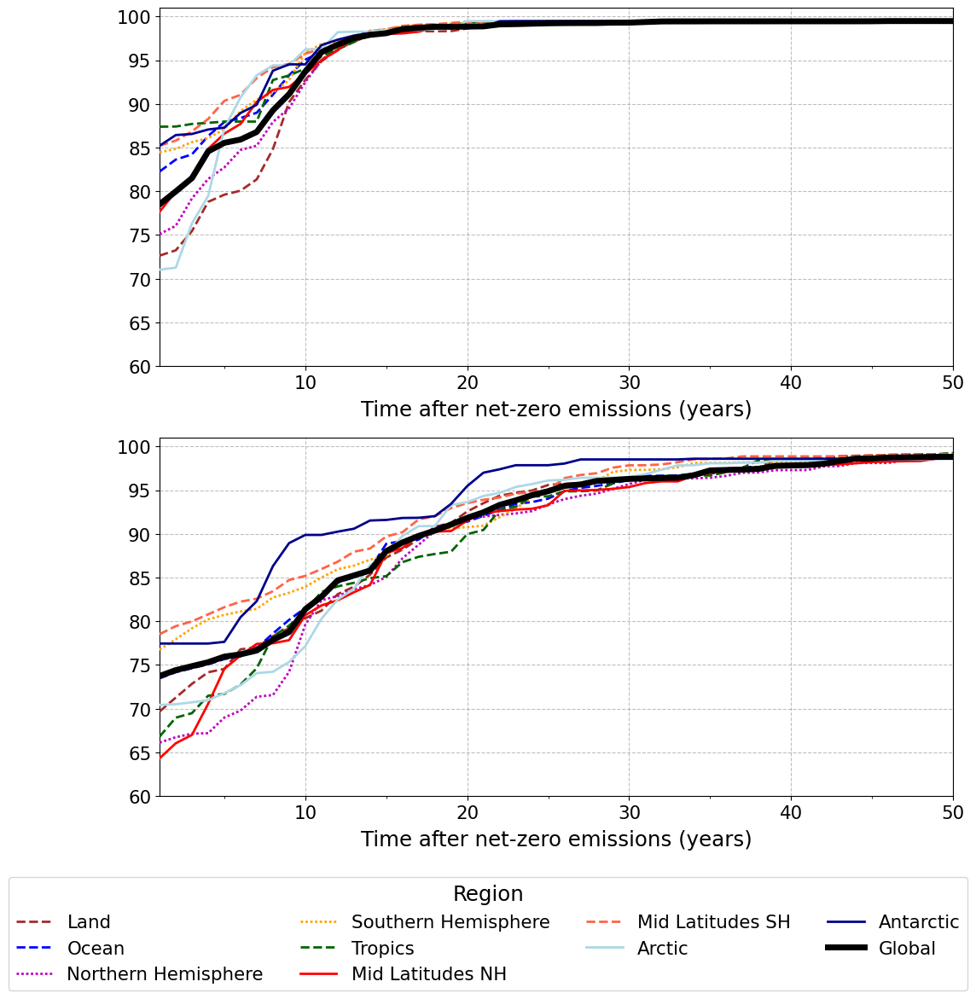

<Figure size 1500x700 with 0 Axes>

<Figure size 1500x700 with 0 Axes>

In [86]:
fig, axes = plt.subplots(nrows=2, figsize=(12, 6*2))

sn_plotting.plot_all_coord_lines(percent_stable_timeseries_ds.sel(window=20).median(dim='model'), ax=axes[0], coord='region', exp_type='region',
                                 add_legend=False, **line_plot_kwargs_median)


fig, ax, leg = sn_plotting.plot_all_coord_lines(percent_stable_timeseries_ds.sel(window=40).median(dim='model'), ax=axes[1], coord='region', exp_type='region',
                                 add_legend=True, bbox_to_anchor=(1.03,-0.2), **line_plot_kwargs_median)

# Update the legend elements
# Get the legend labels
labels = [text.get_text() for text in leg.get_texts()]
for old_label, new_label in NAMING_MAP.items(): 
    try:leg.get_texts()[labels.index(old_label)].set_text(new_label)
    except ValueError: pass

### 1D Lat Lon Selection

In [87]:
from classes import LocationsLatLon
import classes

In [88]:
def get_location_title(location: LocationsLatLon) -> str:
    lat,lon = location.value

    str_lat = str(abs(round(lat, 1)))
    str_lon = str(abs(round(lon, 1)))
    str_lat = str_lon + 'N' if lat > 0 else str_lon + 'S'
    str_lon = str_lon +'E' if lon > 0 else str_lon + 'W'
    location_name = location.name.replace('_', ' ').title()
    location_title = f'{location_name}'  + r' ({}, {})'.format(str_lat, str_lon)
    return location_title

In [89]:
def plot_single_point_all_models(ds, location: LocationsLatLon, length =50, start=0,
                                 fig=None, ax=None, legend_on: bool=True, bbox_to_anchor = [-0.03, 1],
                                ylabel=None, xlabel=None, ylim=None, linestyle=':'):
    lat,lon = location.value
    plt.style.use('seaborn-darkgrid')

    models = [model for model in list(constants.ZECMIP_MODEL_PARAMS) if model in ds.model.values]

    if fig is None: fig  = plt.figure(figsize=(10,8)); ax = fig.add_subplot(111)
        
    for model in models:
        da = (ds.sel(model=model)
              .isel(time=slice(start, length))
              .sel(lat=lat, lon=lon, method='nearest')
             )
        color = constants.ZECMIP_MODEL_PARAMS[model]['color']
        da.plot(ax=ax, label=model, linestyle=linestyle, color=color)
    if legend_on:
        leg = ax.legend()
        ax.legend(ncol=1, fontsize=15, bbox_to_anchor=bbox_to_anchor, frameon=True)
        leg.get_title().set_fontsize('15')
    ax.set_xlim(ds.time.values[start], ds.time.values[length])
    
    ax.set_title(get_location_title(location))
    ax.tick_params(axis='x', labelsize=12)
    ax.tick_params(axis='y', labelsize=12)
    
    if ylabel: ax.set_ylabel(ylabel,fontsize = 16, rotation = 0, labelpad = 55)
    if xlabel: ax.set_xlabel(xlabel, fontsize=16)
    if ylim: ax.set_ylim(ylim)
        
    return fig, ax

In [90]:
def local_point_plot(values_ds, stable_values_ds, window, location, stable_points, fig=None, ax=None,
                    legend_on=True, ylabel=None, xlabel=None, ylim=None):

    fig, ax = plot_single_point_all_models(
        stable_values_ds.sel(window=window), location, fig=fig, ax=ax, linestyle='solid',
        legend_on=legend_on)

    plot_single_point_all_models(values_ds, location, fig=fig, ax=ax, legend_on=False,
      ylabel=f'{ylabel_name}\n{constants.VARIABLE_INFO[variable]["units"]}',
                                xlabel='Time after net-zero emissions (years)')

    for model, point in stable_points[window].items():
        color = color = constants.MODEL_PARAMS[model.lower()]['color']
        ax.scatter(point[0], point[1], zorder=100, color=color, edgecolor='k', s=25)
        
    if ylabel: ax.set_ylabel(ylabel,fontsize = 16, rotation = 0, labelpad = 55)
    if xlabel: ax.set_xlabel(xlabel, fontsize=16)
    if ylim:ax.set_ylim(ylim)
    ax.tick_params(axis='x', labelsize=12)
    ax.tick_params(axis='y', labelsize=12)
        
    return fig, ax

In [91]:
def plot_lat_lon_value_and_sn(value_ds, sn_ds, stable_ds, location, fig=None, gs=None, axes=None,
                              config=None):
    '''
    Plots the temperature, signal-to-noise, s-n bounds, and year of stabilization
    all on different axes subplots.

    Parameters:
    - value_ds: DataArray of temperature values.
    - sn_ds: DataArray of signal-to-noise values.
    - stable_ds: DataArray of stabilization values.
    - location: An object of class locationsLatLon2.
    - config: Configuration dictionary (optional).
    '''

    signal_colors = ['red', 'orange']

    lat, lon = location.value
    models = value_ds.model.values
    value_ds_lat_lon = value_ds.sel(lat=lat, lon=lon, method='nearest')
    stable_ds_lat_lon = stable_ds.sel(lat=lat, lon=lon, method='nearest')
    sn_ds_lat_lon = sn_ds.sel(lat=lat, lon=lon, method='nearest')

    # Use the provided configuration or set defaults
    config_default = {
        'figsize': (10, 24),
        'subplot_layout': (1, 1),
        'contour_levels': None,
        'vmax': None,
        'vmin': None,
        'vmax2': None,
        'font_scale': 1.4,
        'max_stabilisation_year': 999,
        'bbox_to_anchor': (1.6, 1.5)
        }

    if config is not None: config = {**config_default, **config}
    else: config = config_default

    # Create a Matplotlib figure with the specified size
    if fig is None:
        fig = plt.figure(figsize=config['figsize'])

    # Set up subplots using the specified layout
    if gs is None and axes is None:
        ncols, nrows = config['subplot_layout']
        gs = gridspec.GridSpec(nrows, ncols, hspace=0.4)
        axes = [fig.add_subplot(gs[i]) for i in range(len(models))]

    # Set contour levels for temperature
    if config['contour_levels'] is None:
        if config['vmax'] is None:
            config['vmax'] = np.ceil(np.abs(value_ds_lat_lon.values).max())
        if config['vmin'] is None:
            config['vmin'] = -config['vmax']
        config['contour_levels'] = np.arange(config['vmin'], config['vmax'] + config['step'], config['step'])

    time = sn_ds_lat_lon.time.dt.year.values

    for model_num, model in enumerate(models):
        ax = axes[model_num]
        ax2 = ax.twinx()

        # This loop plots the signal-to-noise time series and the stable year
        for num, window in enumerate(stable_ds_lat_lon.window.values):
            # Signal-to-noise
            ax2.plot(time, sn_ds_lat_lon.sel(window=window).signal_to_noise.sel(model=model).values,
                     color=signal_colors[num], label=f'SN Ratio ({window}-year window)')

            # The year at which the time series becomes stable
            stable_year = int(stable_ds_lat_lon.sel(model=model).sel(window=window).time.values[0])

            # Only plot if stable year is within possible range
            if stable_year < config['max_stabilisation_year']:
                sn_at_stable_year = sn_ds_lat_lon.sel(window=window, model=model).isel(time=stable_year).signal_to_noise.values
                ax2.scatter(time[stable_year], sn_at_stable_year, color=signal_colors[num], label=f'Stabilization Year\n({window}-year window)',
                           s=100, edgecolor='k')

            # Getting lower bound (lb) and upper bound values
            lb = sn_ds_lat_lon.sel(window=window, model=model).lower_bound.values
            ub = sn_ds_lat_lon.sel(window=window, model=model).upper_bound.values

            bounds_kwargs = dict(color=signal_colors[num], linestyle='--', alpha=1)

            # Plot the bounds
            ax2.plot(time, [lb] * len(time), label=f'{window}-year Window Bounds', **bounds_kwargs)
            ax2.plot(time, [ub] * len(time), **bounds_kwargs)

        # Plot temperature data
        full_time = value_ds_lat_lon.time.dt.year.values
        ax.plot(full_time, value_ds_lat_lon.sel(model=model).values, color='blue')



        ###### Formatting
        # Add a legend to the first subplot
        if model_num == 0:ax2.legend(ncol=3, bbox_to_anchor=config['bbox_to_anchor'], fontsize=constants.PlotConfig.legend_text_size*config_default['font_scale'])
            
        # Set y-axis limits for signal-to-noise and temperature
        if config['vmax2']: ax2.set_ylim(-config['vmax2'], config['vmax2'])
        ax.set_ylim(config['vmin'], config['vmax'])
        
        # Add a grid to the plot
        ax.grid(True, linestyle='--', color='gray', alpha=0.2)

        # Match y-axis ticks between the two plots
        ax, ax2 = plotting_functions.match_ticks(ax, ax2, 'left')

                
        if (model_num+1)%2 and model_num!=8: # Left plot  and model_num<7
            #ax2.set_yticklabels([])#; ax2.set_yticks([]); 
            ax2.set_yticklabels([]); ax2.set_ylabel(' ')#; ax2.set_yticks([]);
            plotting_functions.clip_axis_ends(ax)
        elif model_num == 8:
            plotting_functions.clip_axis_ends(ax)
            plotting_functions.clip_axis_ends(ax2)
            ax2.set_ylabel(' '); ax2.set_ylabel(' ')
        else: # Right plot 
            ax.set_yticklabels([]); ax.set_ylabel(' ')#; ax.set_yticks([]); 
            plotting_functions.clip_axis_ends(ax2)

        ax2.set_ylabel(''); ax.set_ylabel('')

        # Onlt a subset of models have a label
        if model_num  == 4: ax.set_ylabel(f'GMST Anomaly({units})', size=constants.PlotConfig.title_size*config_default['font_scale'])
        if model_num  == 5: ax2.set_ylabel("Signal-to-Noise Ratio" , size=constants.PlotConfig.title_size*config_default['font_scale'])

        # At the model in 
        ax.annotate(model, xy=(0.75, 0.85), xycoords='axes fraction', ha='left', size=constants.PlotConfig.title_size*config_default['font_scale'])

        # Format the tick size, the x-axis label
        plotting_functions.format_axis(ax, xlabel='Time after net zero emissions (years)', font_scale=config_default['font_scale']) 
        plotting_functions.format_axis(ax2, xlabel='Time after net zero emissions (years)', font_scale=config_default['font_scale'])

        # X lim
        ax.set_xlim(np.take(full_time, [0, -1]))

    return fig

In [92]:
Locations = classes.locationsLatLon2

In [93]:
dir(Locations)

['ANTARCTIC',
 'ARCTIC',
 'EASTERN_PACIFIC',
 'NORTHERN_EUROPE',
 'SOLOMON_ISLANDS',
 'SOUTHERN_OCEAN',
 '__class__',
 '__doc__',
 '__members__',
 '__module__']

In [94]:
location = Locations.SOUTHERN_OCEAN
location

<locationsLatLon2.SOUTHERN_OCEAN: (-54, 145.69)>

In [95]:
LOCATION_MINMAXSTEP = {
    Locations.SOUTHERN_OCEAN: dict(step=.2, vmax=1.4, vmin=-1.2),
    Locations.ARCTIC: dict(step=.2, vmax=5, vmin=-5),
    Locations.EASTERN_PACIFIC: dict(step=.2, vmax=1.4, vmin=-1.2),
    Locations.SOLOMON_ISLANDS: dict(step=.2, vmax=1.4, vmin=-1.2),
    Locations.ANTARCTIC: dict(step=.2, vmax=3.5, vmin=-3.5),
    Locations.NORTHERN_EUROPE: dict(step=.2, vmax=3, vmin=-3),
}

In [96]:
location_minmaxstep = LOCATION_MINMAXSTEP[location]

In [97]:
sn_multi_rolling_ds.lower_bound.sel(window=20, model='MPI-ESM1-2-LR' ).sel(lat=location.value[0], lon=location.value[1], method='nearest')

<xarray.DataArray 'lower_bound' ()>
-2.31
Coordinates:
    lat       float64 -53.16
    lon       float64 146.2
    model     <U14 'MPI-ESM1-2-LR'
    window    int64 20
    ensemble  <U8 'r1i1p1f1'

9 2 5


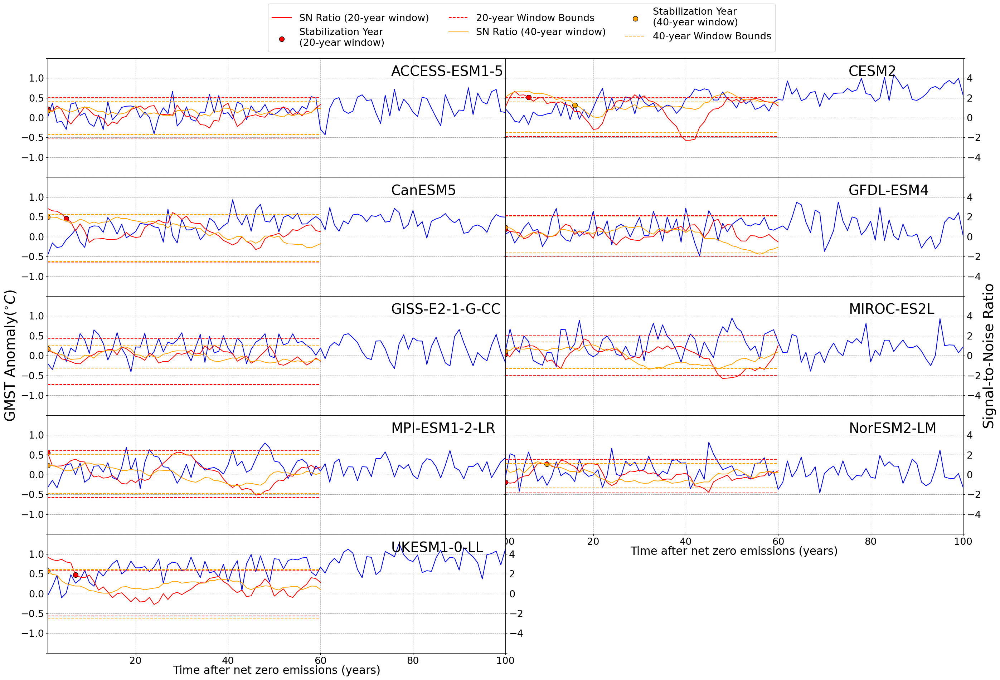

In [98]:
num_plots = len(a1_anom_ds.model.values)
num_cols = 2
num_rows = int(np.ceil(num_plots/num_cols))
fig = plt.figure(figsize=(sn_plotting.plot_kwargs['width']*1.5,  sn_plotting.plot_kwargs['height']*num_plots/5))
gs = gridspec.GridSpec(num_rows, num_cols, wspace=0, hspace=0)
print(num_plots, num_cols, num_rows)
axes = [fig.add_subplot(gs[i]) for i in range(nplots-2)]
fig = plot_lat_lon_value_and_sn(a1_anom_ds, sn_multi_rolling_ds.isel(time=slice(None, 60)), rolling_year_stable_local, location,
                                fig=fig, gs=gs, axes=axes, config=dict(**location_minmaxstep, vmax2=6, max_stabilisation_year = 40))

# Remove xticklabels for all bust last axis -  ends can still be seen otherwise
[ax.set_xticklabels([]) for num, ax in enumerate(axes) if num < 6];

In [99]:
location.value

(-54, 145.69)

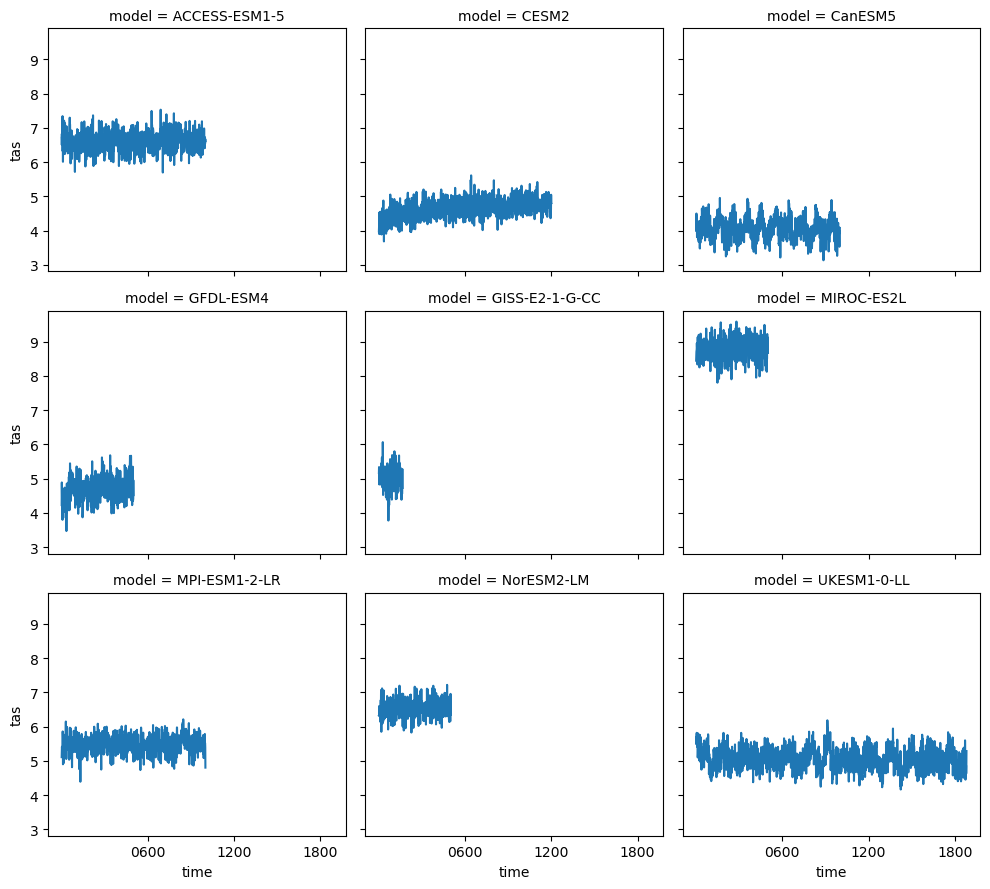

In [100]:
esmpi_ds.sel(lat=location.value[0], lon=location.value[1], method='nearest').plot(col='model',  col_wrap=3)

In [101]:
# location = classes.locationsLatLon2.SOUTHERN_OCEAN
# fig = plot_lat_lon_value_and_sn(a1_anom_ds, sn_multi_rolling_ds.isel(time=slice(None, 60)),
#                           rolling_year_stable_local,location, step=1, vmax=4, vmin=-4, vmax2=6, max_stabilisation_year = 40)

In [102]:
# location = classes.locationsLatLon2.SOUTHERN_OCEAN

# nplots = len(a1_anom_ds.model.values)
# fig = plt.figure(figsize=(12, 3*nplots))
# gs = gridspec.GridSpec(nplots, 1, wspace=0, hspace=0)
# axes = [fig.add_subplot(gs[i]) for i in range(nplots)]
# fig = plot_lat_lon_value_and_sn(a1_anom_ds, sn_multi_rolling_ds.isel(time=slice(None, 60)), rolling_year_stable_local, location,
#                                 fig=fig, gs=gs, axes=axes, config=dict(step=.2, vmax=1.4, vmin=-1.2, vmax2=6, max_stabilisation_year = 40))

### Geo2D

In [103]:
# One projeciton for when it is to be passed into a function. The other is when I am using it here.
# The passed function version also then used the same central longitude.
projection = ccrs.PlateCarree
projection_init = ccrs.PlateCarree(central_longitude=np.mean(sn_multi_rolling_ds.lon.values))

In [104]:
rolling_year_stable_local.isel(window=0)

<xarray.Dataset>
Dimensions:   (lat: 96, lon: 192, model: 9, variable: 1)
Coordinates:
  * lat       (lat) float64 -88.57 -86.72 -84.86 -83.0 ... 84.86 86.72 88.57
  * lon       (lon) float64 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * model     (model) <U14 'ACCESS-ESM1-5' 'CESM2' ... 'UKESM1-0-LL'
    window    int64 20
    ensemble  <U8 'r1i1p1f1'
  * variable  (variable) object 'signal_to_noise'
Data variables:
    time      (variable, model, lat, lon) int64 5 5 5 5 5 5 ... 45 45 45 46 46

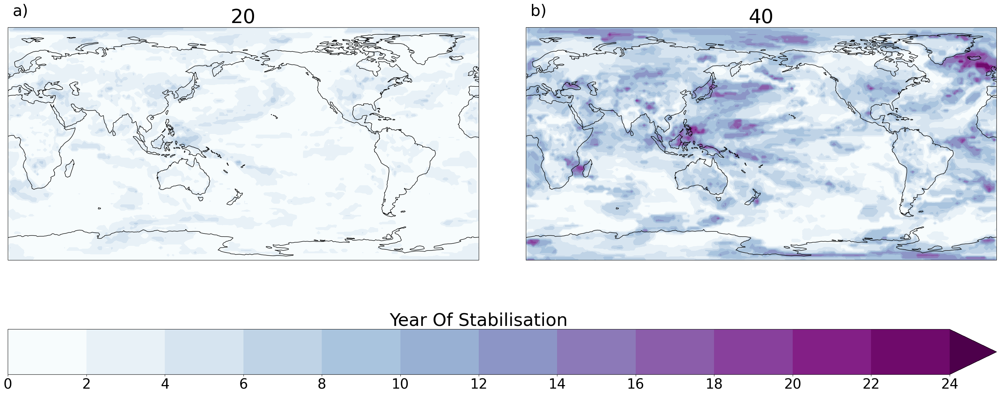

In [105]:
vm =24; step=2; levels_mean_stab= np.arange(0, vm+step, step)
fig = plt.figure(figsize=(18*2, 14))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze(), dim='window', fig=fig,
    levels=levels_mean_stab, ncols=2, projection=projection, cmap='BuPu', extend='max',
    cbar_title="Year Of Stabilisation", font_scale=2)

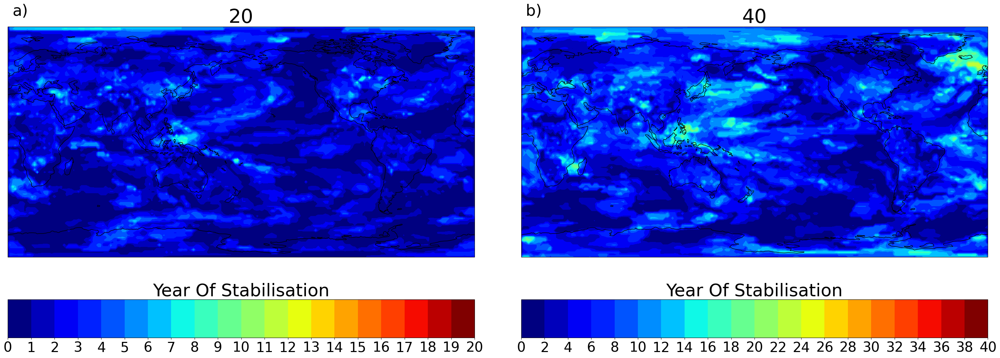

In [106]:
vm =40; step=2; levels_mean_stab2 = np.arange(0, vm+step, step)
vm =20; step=1; levels_mean_stab1 = np.arange(0, vm+step, step)

fig = plt.figure(figsize=(18*2, 12))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze(), dim='window', fig=fig,
    levels=[levels_mean_stab1, levels_mean_stab2], projection=projection, ncols=2, extend='neither', cmap='jet',#'gist_earth_r',
    cbar_title="Year Of Stabilisation", font_scale=2)

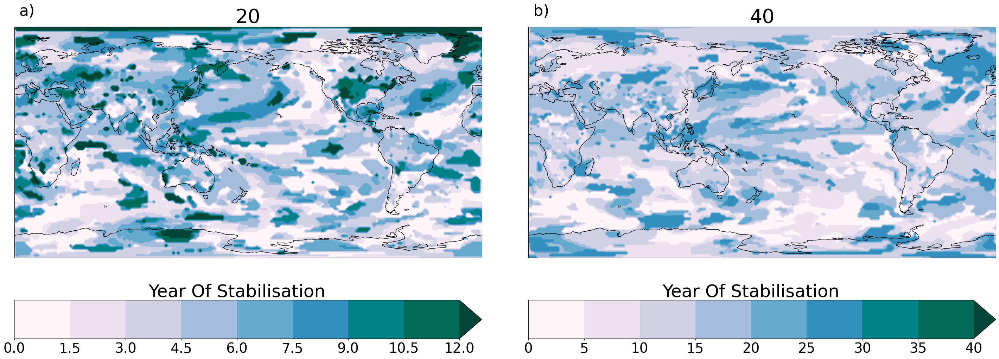

In [107]:
vm =40; step=5; levels_mean_stab2 = np.arange(0, vm+step, step)
vm =12; step=1.5; levels_mean_stab1 = np.arange(0, vm+step, step)

fig = plt.figure(figsize=(18*2, 12))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['uncertainty'].squeeze(), dim='window', fig=fig,
    levels=[levels_mean_stab1, levels_mean_stab2], projection=projection, ncols=2, cmap='PuBuGn', extend='max',
    cbar_title="Year Of Stabilisation", font_scale=2)

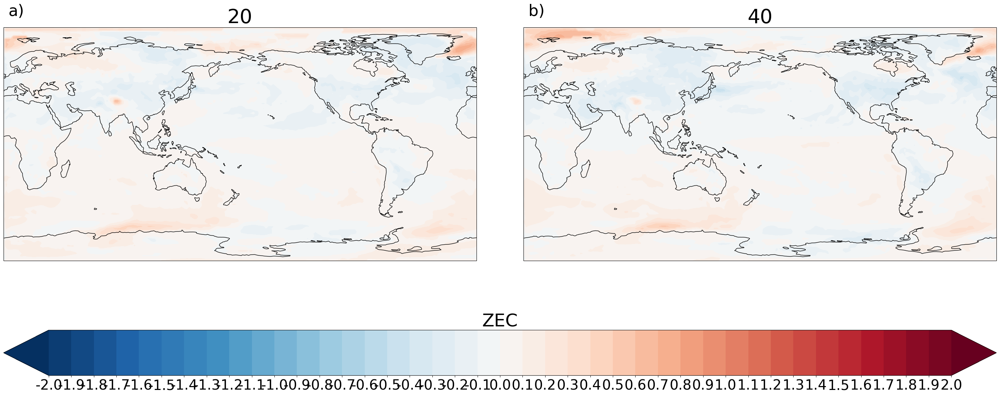

In [108]:
vm = 2; step=.1; levels_mean_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig = plt.figure(figsize=(18*2, 14))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    stable_anom_da.mean(dim='model'), projection=projection, dim='window', fig=fig, levels=levels_mean_anom, ncols=2,
    cbar_title="ZEC", font_scale=2)

In [109]:
universaL_kwargs = dict(ncols=2, font_scale=2, add_label=False)

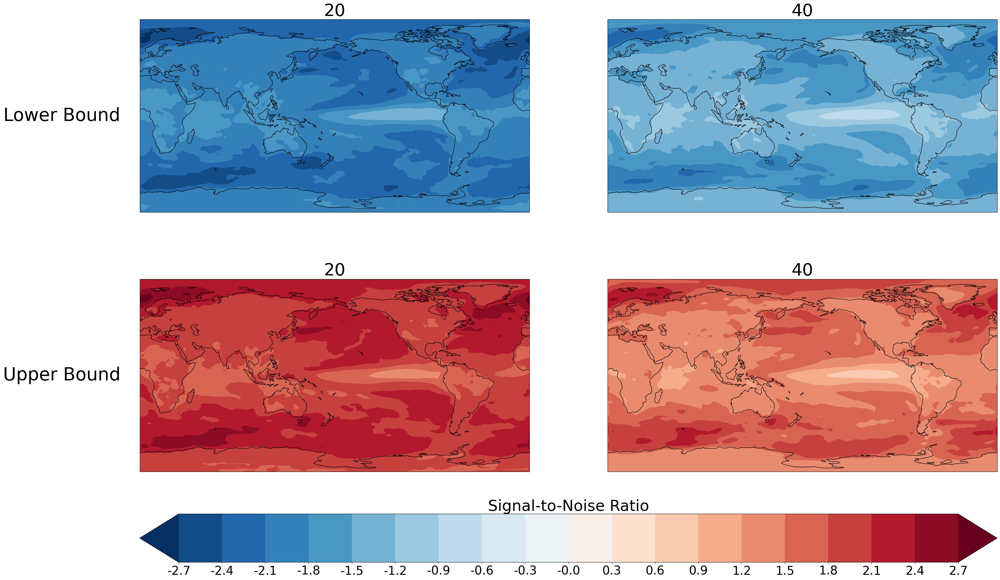

In [110]:
# All mean value plots
ntypes = 2

fig = plt.figure(figsize=(18*2, 12*ntypes))
gs = gridspec.GridSpec(3, 2, height_ratios = [1, 1, 0.2], hspace=0.1)
# projection = ccrs.Robinson(central_longitude=int(np.mean(rollling_year_stable_local_average.lon.values)))

all_axes = []

bound = 2.7; step=0.3; signal_to_noise_levels = np.arange(-bound, bound+step, step)

fig, gs, axes = sn_plotting.map_plot_all_for_coords_3(
    sn_multi_rolling_ds.mean(dim='model')['lower_bound'], dim='window',
    levels=signal_to_noise_levels, projection=projection, cmap='RdBu_r',
    cbar_title="Signal-to-Noise Ratio",
    fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[0, 0], projection=projection_init),
            fig.add_subplot(gs[0, 1], projection=projection_init)],
#     cax = [plt.subplot(gs[1, :])],
    add_colorbar=False,
    **universaL_kwargs)

all_axes.extend(axes)

fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    sn_multi_rolling_ds.mean(dim='model')['upper_bound'], dim='window',
    levels=signal_to_noise_levels, cmap='RdBu_r',
    cbar_title="Signal-to-Noise Ratio",
    fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[1, 0], projection=projection_init),
            fig.add_subplot(gs[1, 1], projection=projection_init)],
    cax = [plt.subplot(gs[2, :])],
    **universaL_kwargs)
all_axes.extend(axes)


y_axis_kwargs = dict(xy=(-0.2, 0.5), ha='center', va='center',
                     xycoords='axes fraction', rotation=0, size=21*universaL_kwargs['font_scale'])
row_labels = ['Lower Bound', 'Upper Bound']
for num, ax in enumerate(all_axes):
    #plotting_functions.add_figure_label(ax, f'{chr(97+num)})', font_scale=universaL_kwargs['font_scale'])
    if num%2 == 0: ax.annotate(row_labels[int(num/2)], **y_axis_kwargs)

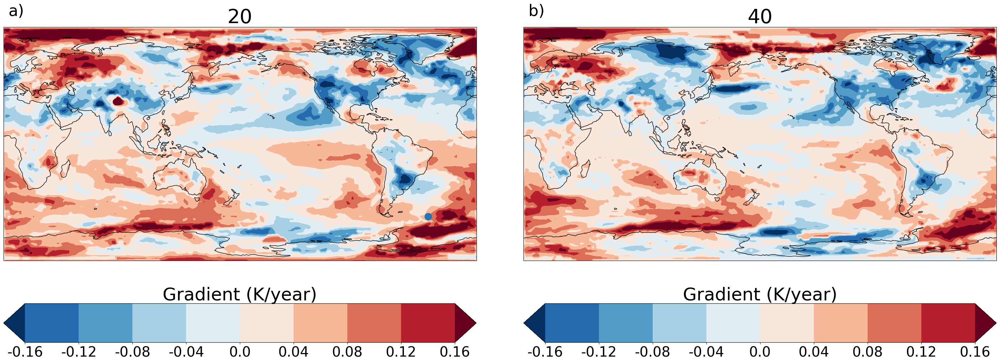

In [111]:
vm =.16; step=.04; levels_mean_stab2 = np.arange(-vm, vm+step, step)
vm =.16; step=.04; levels_mean_stab1 = np.arange(-vm, vm+step, step)

fig = plt.figure(figsize=(18*2, 12))
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    gradient_da.mean(dim='model').squeeze(), projection=projection, dim='window', fig=fig,
    levels=[levels_mean_stab1, levels_mean_stab2], ncols=2, cmap='RdBu_r', extend='both',
    cbar_title="Gradient (K/year)", font_scale=2)
axes[0].scatter(142.69, -55, s=200)

In [112]:
reload(sn_plotting)

<module 'sn_plotting' from '/home/563/ab2313/Documents/PhD/modules/sn_plotting.py'>

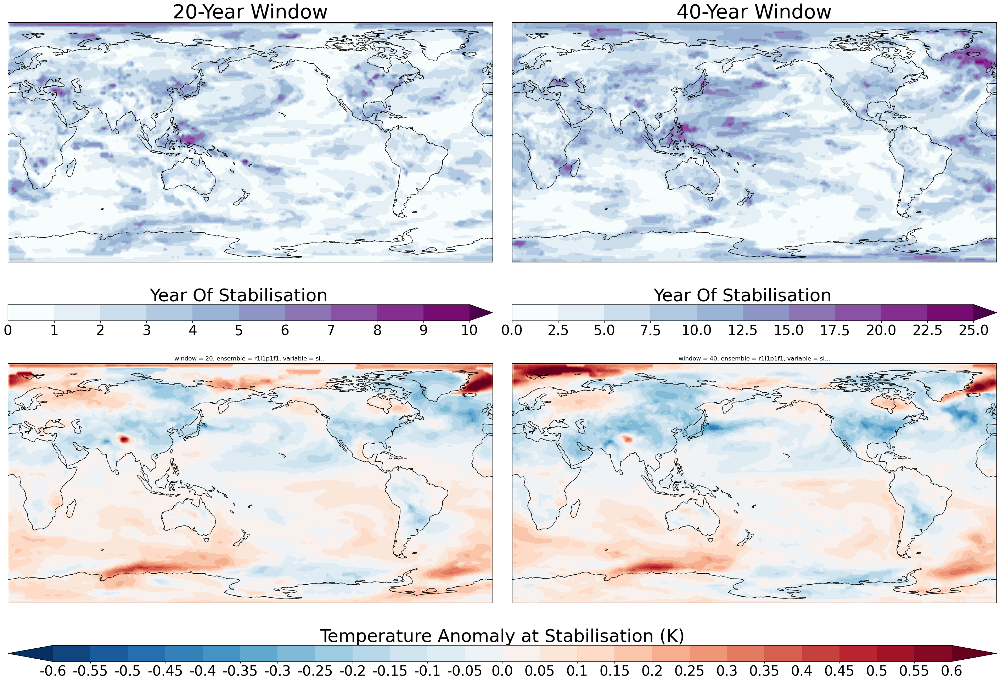

In [113]:
# All mean value plots
ntypes = 2

fig = plt.figure(figsize=(18*2, 12.5*ntypes))
gs = gridspec.GridSpec(ntypes*2, 2, height_ratios = [1, 0.05]*ntypes, hspace=0, wspace=0.04)
#projection = ccrs.PlateCarree #ccrs.Robinson(central_longitude=int(np.mean(rollling_year_stable_local_average.lon.values)))

universaL_kwargs = dict(ncols=2, font_scale=2, add_label=False)
all_axes = []

### Year of Stabilisation
# vm =40; step=2; levels_mean_stab2 = np.arange(0, vm+step, step)
# vm =20; step=1; levels_mean_stab1 = np.arange(0, vm+step, step)
### Year of Stabilisation
vm=25; step=2.5; levels_mean_stab2 = np.arange(0, vm+step, step)
vm=10; step=1; levels_mean_stab1 = np.arange(0, vm+step, step)

fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze(), dim='window',
    levels=[levels_mean_stab1, levels_mean_stab2], cmap='BuPu', extend='max',
    cbar_title="Year Of Stabilisation", title_tag='-Year Window',
    fig=fig, gs=gs, projection=projection,
    axes = [fig.add_subplot(gs[0, 0], projection=projection_init),
            fig.add_subplot(gs[0, 1], projection=projection_init)],
    cax = [plt.subplot(gs[1, 0]), plt.subplot(gs[1, 1])],
    **universaL_kwargs)
all_axes.extend(axes)


### Temperature Anomaly at Stabilisation
vm = .6; step=.05; levels_mean_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    stable_anom_da.mean(dim='model'), dim='window', levels=levels_mean_anom, cbar_title="Temperature Anomaly at Stabilisation (K)",
    fig=fig, gs=gs, projection=projection, add_title=False,
    axes = [fig.add_subplot(gs[2, 0], projection=projection_init),
            fig.add_subplot(gs[2, 1], projection=projection_init)],
    cax = [plt.subplot(gs[3, :])],
    **universaL_kwargs)
all_axes.extend(axes)

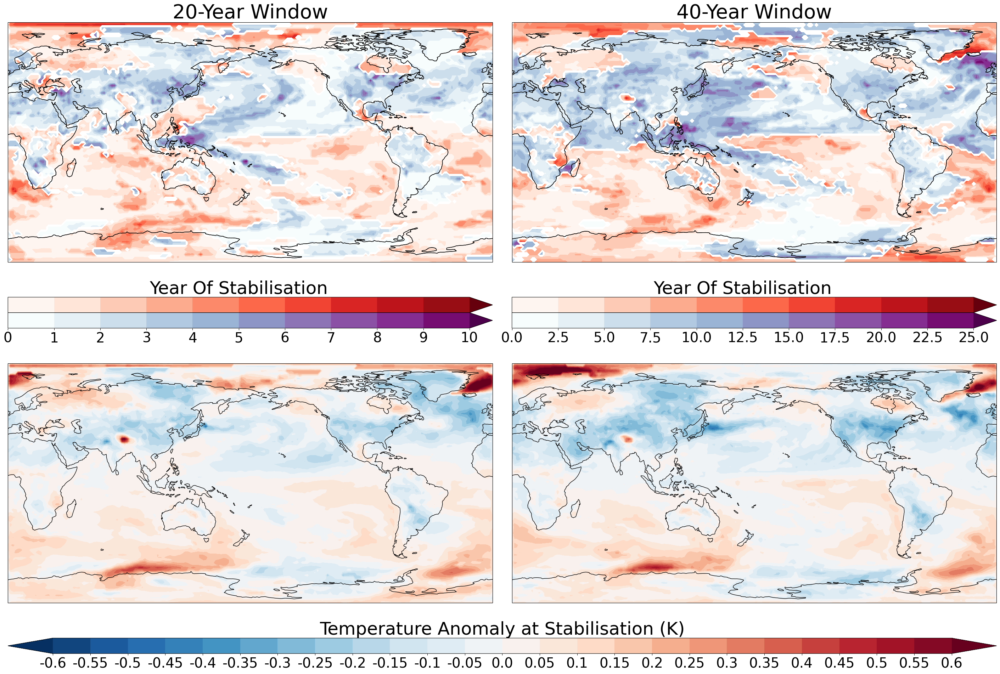

In [114]:
# All mean value plots
ntypes = 2

fig = plt.figure(figsize=(18*2, 12.5*ntypes))
gs = gridspec.GridSpec(ntypes*3, 2, height_ratios = [1, 0.05, 0.05]*ntypes, hspace=0, wspace=0.04)

universaL_kwargs = dict(ncols=2, font_scale=2, add_label=False, projection=projection)

### Year of Stabilisation
vm=25; step=2.5; levels_mean_stab2 = np.arange(0, vm+step, step)
vm=10; step=1; levels_mean_stab1 = np.arange(0, vm+step, step)


# Create tha xis and color axis
top_axes = [fig.add_subplot(gs[0, 0], projection=projection_init), fig.add_subplot(gs[0, 1], projection=projection_init)]
bottom_axes = [fig.add_subplot(gs[3, 0], projection=projection_init), fig.add_subplot(gs[3, 1], projection=projection_init)]
top_cax1 = [plt.subplot(gs[1, 0]), plt.subplot(gs[1, 1])]
bottom_cax1 = [plt.subplot(gs[2, 0]), plt.subplot(gs[2, 1])]
cax2 = [plt.subplot(gs[4, :])]

top_kwargs = dict(dim='window',levels=[levels_mean_stab1, levels_mean_stab2], extend='max', title_tag='-Year Window')

fig, gs, axes, cbar1 = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze().where(stable_anom_da.mean(dim='model')>0),
    fig=fig, gs=gs, axes = top_axes,  cbar_title="Year Of Stabilisation", cmap='Reds', cax = top_cax1,
    **universaL_kwargs, **top_kwargs)

fig, gs, axes, cbar2 = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze().where(stable_anom_da.mean(dim='model')<0),
    fig=fig, gs=gs, axes = top_axes, cmap='BuPu', cax = bottom_cax1,
    **universaL_kwargs, **top_kwargs)

# Remove the xticklabels and the xticks from the top colorbar
[cbar.ax.set_xticklabels([]) for cbar in cbar1]
[cbar.ax.set_xticks([]) for cbar in cbar1]

### Temperature Anomaly at Stabilisation
vm = .6; step=.05; levels_mean_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    stable_anom_da.mean(dim='model'), dim='window', levels=levels_mean_anom, cbar_title="Temperature Anomaly at Stabilisation (K)",
    fig=fig, gs=gs, add_title=False, axes = bottom_axes, cax = cax2,**universaL_kwargs)


for ax in bottom_axes: ax.set_title('')

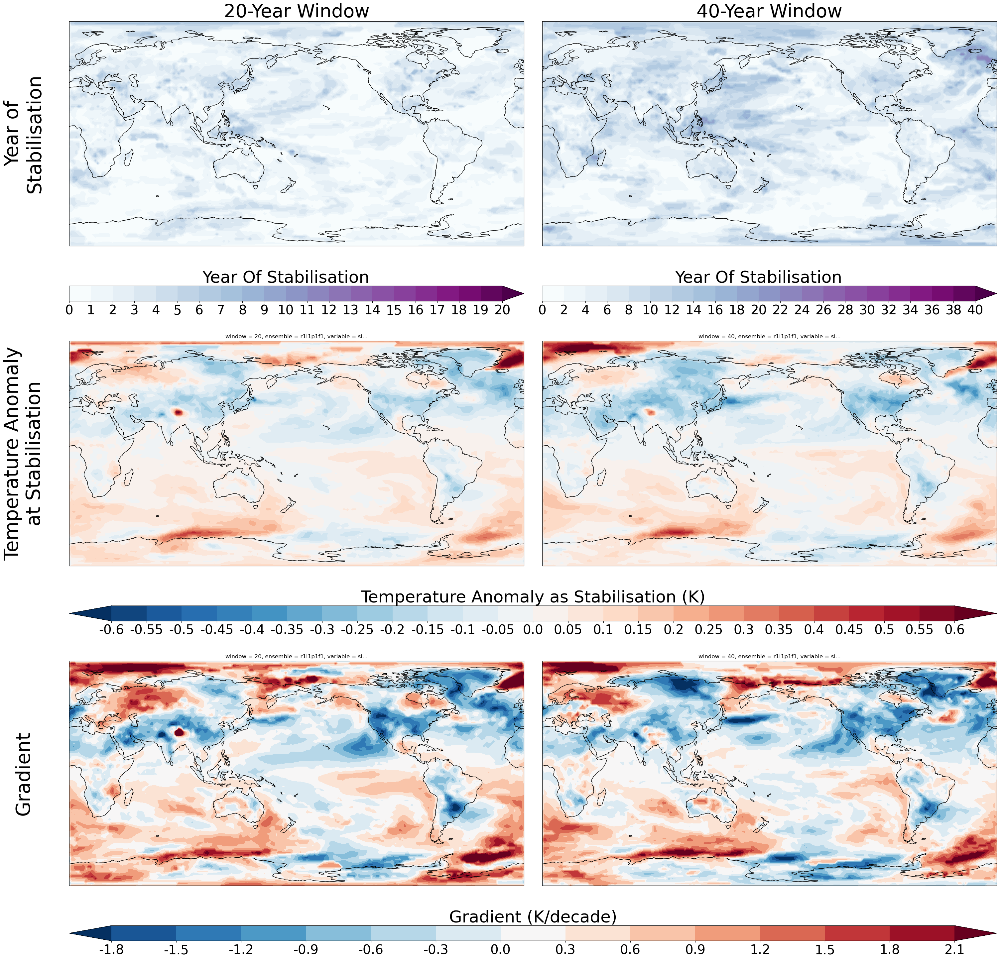

In [115]:
# All mean value plots
ntypes = 3

fig = plt.figure(figsize=(18*2, 12.5*ntypes))
gs = gridspec.GridSpec(ntypes*2, 2, height_ratios = [1, 0.05]*ntypes, hspace=0, wspace=0.04)
#projection = ccrs.PlateCarree #ccrs.Robinson(central_longitude=int(np.mean(rollling_year_stable_local_average.lon.values)))

universaL_kwargs = dict(ncols=2, font_scale=2, add_label=False)
all_axes = []

### Year of Stabilisation
vm =40; step=2; levels_mean_stab2 = np.arange(0, vm+step, step)
vm =20; step=1; levels_mean_stab1 = np.arange(0, vm+step, step)
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rollling_year_stable_local_average['average_value'].squeeze(), dim='window',
    levels=[levels_mean_stab1, levels_mean_stab2], cmap='BuPu', extend='max',
    cbar_title="Year Of Stabilisation", title_tag='-Year Window',
    fig=fig, gs=gs, projection=projection,
    axes = [fig.add_subplot(gs[0, 0], projection=projection_init),
            fig.add_subplot(gs[0, 1], projection=projection_init)],
    cax = [plt.subplot(gs[1, 0]), plt.subplot(gs[1, 1])],
    **universaL_kwargs)
all_axes.extend(axes)


### Temperature Anomaly at Stabilisation
vm = .6; step=.05; levels_mean_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    stable_anom_da.mean(dim='model'), dim='window', levels=levels_mean_anom, cbar_title="Temperature Anomaly as Stabilisation (K)",
    fig=fig, gs=gs, projection=projection, add_title=False,
    axes = [fig.add_subplot(gs[2, 0], projection=projection_init),
            fig.add_subplot(gs[2, 1], projection=projection_init)],
    cax = [plt.subplot(gs[3, :])],
    **universaL_kwargs)
all_axes.extend(axes)


### Gradient
vm =.18; step=.03; levels_mean_grad = np.arange(-vm, vm+step, step)
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    gradient_da.mean(dim='model').squeeze()*10, dim='window',
    levels=levels_mean_grad*10, projection=projection, cmap='RdBu_r', extend='both', cbar_title="Gradient (K/decade)",
    fig=fig, gs=gs, add_title=False,
    axes = [fig.add_subplot(gs[4, 0], projection=projection_init),
            fig.add_subplot(gs[4, 1], projection=projection_init)],
    cax = [plt.subplot(gs[5, :])]#, plt.subplot(gs[5, 1])]
    , **universaL_kwargs)
all_axes.extend(axes)

y_axis_kwargs = dict(xy=(-.1, .5), ha='center', va='center', # (-0.3, 0.5) for rotation 0
                     xycoords='axes fraction', rotation=90, size=21*universaL_kwargs['font_scale'])
row_labels = ['Year of\nStabilisation', 'Temperature Anomaly\nat Stabilisation', 'Gradient']
for num, ax in enumerate(all_axes):
    #plotting_functions.add_figure_label(ax, f'{chr(97+num)})', font_scale=universaL_kwargs['font_scale'])
    if num%2 == 0: ax.annotate(row_labels[int(num/2)], **y_axis_kwargs)

In [116]:
vm = 36; step=3; levels_window_different = np.arange(-vm, vm+step, step) 

Text(0.9, -1, '40-year window stabilises later')

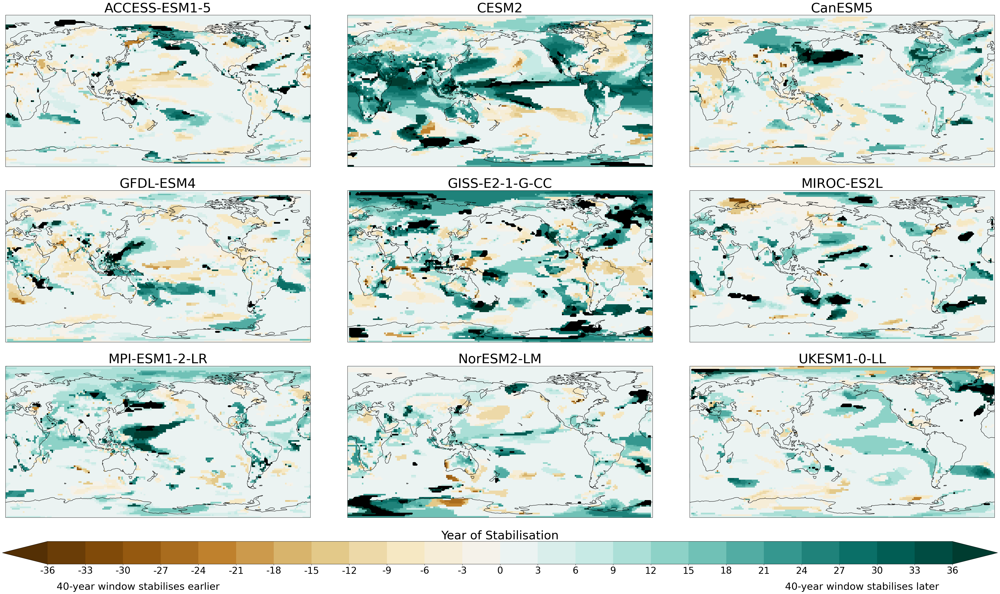

In [117]:
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    (rolling_year_stable_local.sel(window=40) - rolling_year_stable_local.sel(window=20)).time.squeeze(),
    dim='model', levels=levels_window_different, cmap='BrBG', extend='both',
    max_stabilisation_year=40, stabilisation_method = 'blackout', add_label=False, ptype='imshow',
    cbar_title="Year of Stabilisation", font_scale=2, projection=ccrs.PlateCarree)


# Add text annotations to the colorbar axes
cbar[0].ax.text(0.1, -1, '40-year window stabilises earlier', ha='center', va='center', fontsize=30, transform=cbar[0].ax.transAxes)
cbar[0].ax.text(0.9, -1, '40-year window stabilises later', ha='center', va='center', fontsize=30, transform=cbar[0].ax.transAxes)


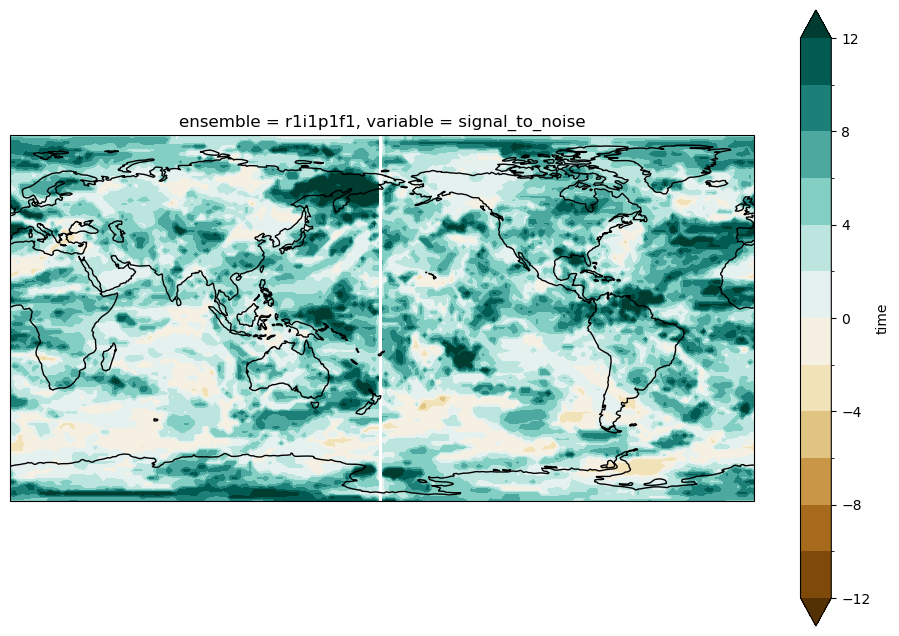

In [118]:
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection=projection_init)
(rolling_year_stable_local.sel(window=40) - rolling_year_stable_local.sel(window=20)
        ).time.squeeze().mean(dim='model').plot.contourf(cmap='BrBG', ax=ax, interpolation='nearest', levels=np.arange(-12, 14, 2), 
                                                      extend='both')
ax.coastlines()

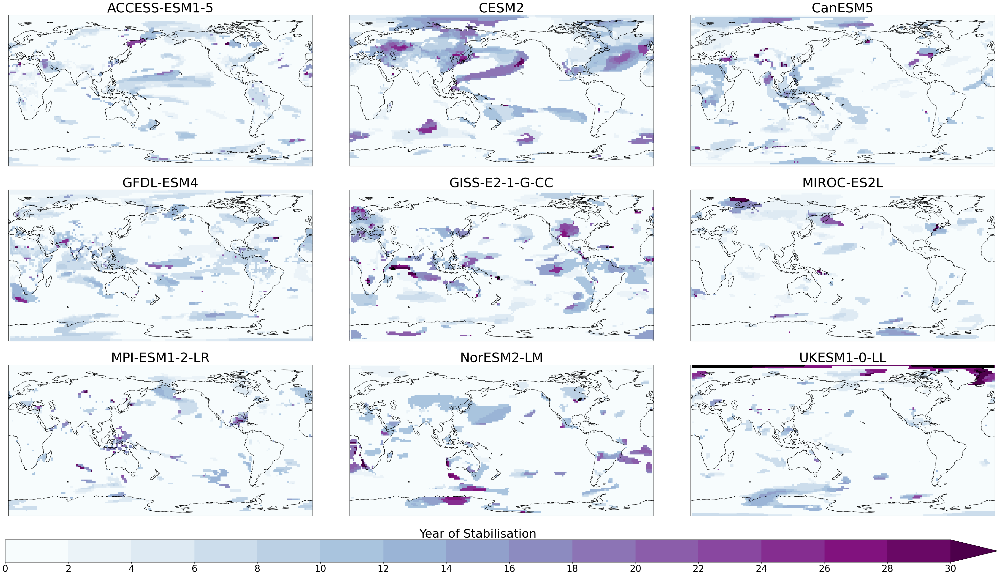

In [119]:
vm = 30; step=2; levels_stable = np.arange(0, vm+step, step) 
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rolling_year_stable_local.sel(window=20).time.squeeze(),
    dim='model', levels=levels_stable, cmap='BuPu', extend='max',
    max_stabilisation_year=40, stabilisation_method = 'blackout', add_label=False, 
    cbar_title="Year of Stabilisation", font_scale=2, projection=ccrs.PlateCarree, ptype='imshow')

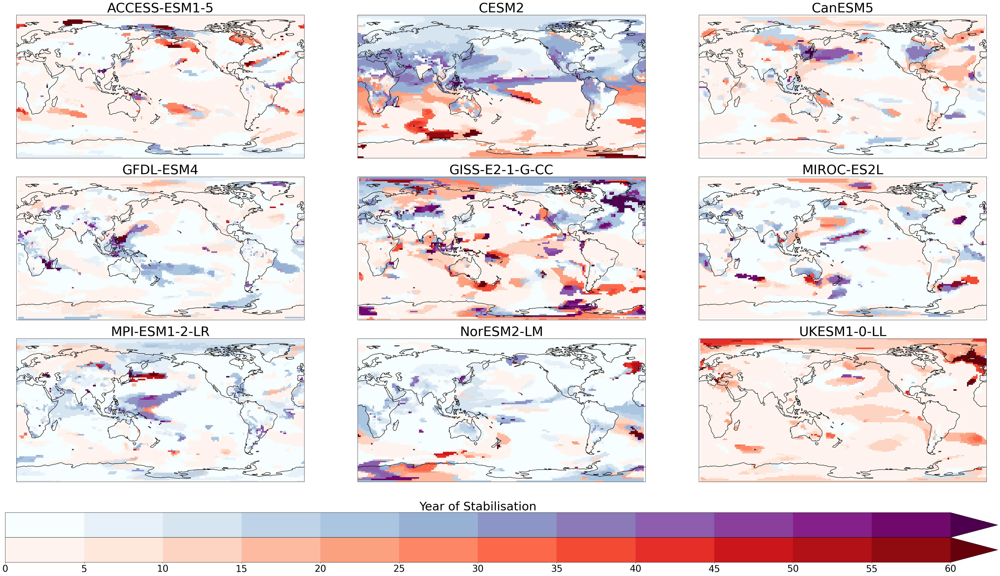

In [120]:

# 20-year window levels
# vm = 30; step=2; levels_stable = np.arange(0, vm+step, step) 
# 40-year window levels
vm = 60; step=5; levels_stable = np.arange(0, vm+step, step) 

window=40

### Figure and axes creation

# If `fig` is not provided, create a new figure with the specified size (default: 18*nrows x 10*ncols).
# If `fig` is already provided, use the existing figure.
# Calculate the total number of plots.
ncols, nrows = 3, 3
num_plots = ncols * nrows

fig = plt.figure(figsize=(18*nrows, 10*ncols))
gs_top = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.15]*2, wspace=.1)
gs_bottom = gridspec.GridSpec(nrows+2, ncols, height_ratios=[1]*nrows+[0.15]*2, hspace=0)

axes = [fig.add_subplot(gs_top[i], projection=projection_init) for i in range(0, num_plots)]
cax1 = plt.subplot(gs_bottom[nrows+0, :])
cax2 = plt.subplot(gs_bottom[nrows+1, :])

### Small calculations - splitting into warm stable and cool stable
year_stable_ds = rolling_year_stable_local.sel(window=window).time.squeeze()
stable_warm_ds = year_stable_ds.where(stable_anom_da.sel(window=window)>0)
stable_cool_ds = year_stable_ds.where(stable_anom_da.sel(window=window)<0)

### Data plotting
# , stabilisation_method = 'blackout'
stable_plot_kwargs = dict(dim='model', levels=levels_stable, extend='max', add_label=False,
    max_stabilisation_year=60, stabilisation_method='blackout', font_scale=2, projection=ccrs.PlateCarree, ptype='imshow')

fig, gs, axes, cbar1 = sn_plotting.map_plot_all_for_coords_3(
    stable_cool_ds, fig=fig, gs=gs_top, axes=axes, cax=cax1, cmap='BuPu',
    cbar_title="Year of Stabilisation", **stable_plot_kwargs)

fig, gs, axes, cbar2 = sn_plotting.map_plot_all_for_coords_3(
    stable_warm_ds, fig=fig, gs=gs_top, axes=axes, cax=cax2, cmap='Reds', **stable_plot_kwargs)

cbar1[0].ax.set_xticklabels([]);
cbar1[0].ax.set_xticks([]);

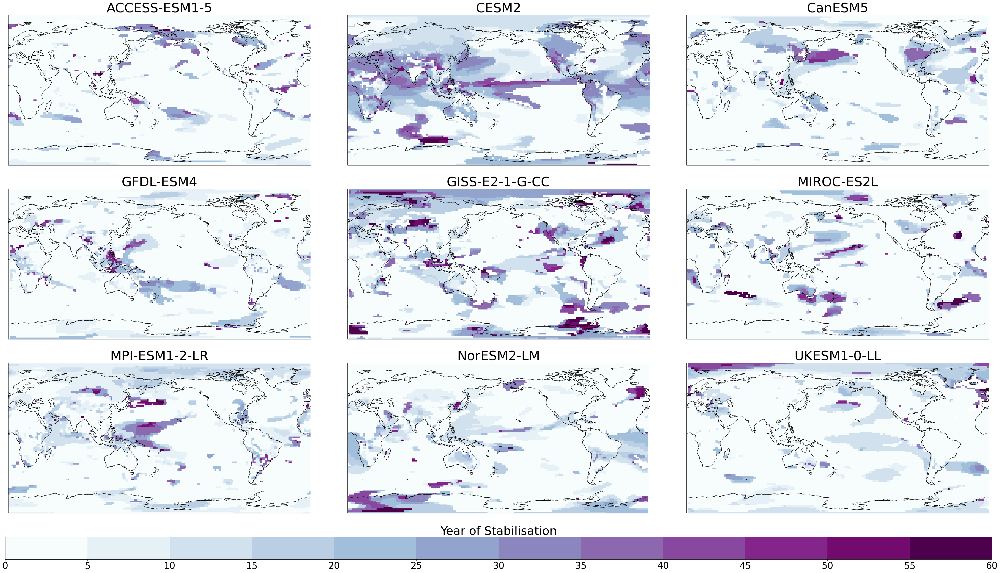

In [121]:
vm = 60; step=5; levels_stable = np.arange(0, vm+step, step) 
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(
    rolling_year_stable_local.sel(window=40).time.squeeze(),
    dim='model', levels=levels_stable, cmap='BuPu', extend='neither', ptype='imshow',
    max_stabilisation_year=max_effective_length, stabilisation_method='blackout', add_label=False,
    cbar_title="Year of Stabilisation", font_scale=2, projection=ccrs.PlateCarree)

In [122]:
vm = 1.2; step=.2; levels_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.

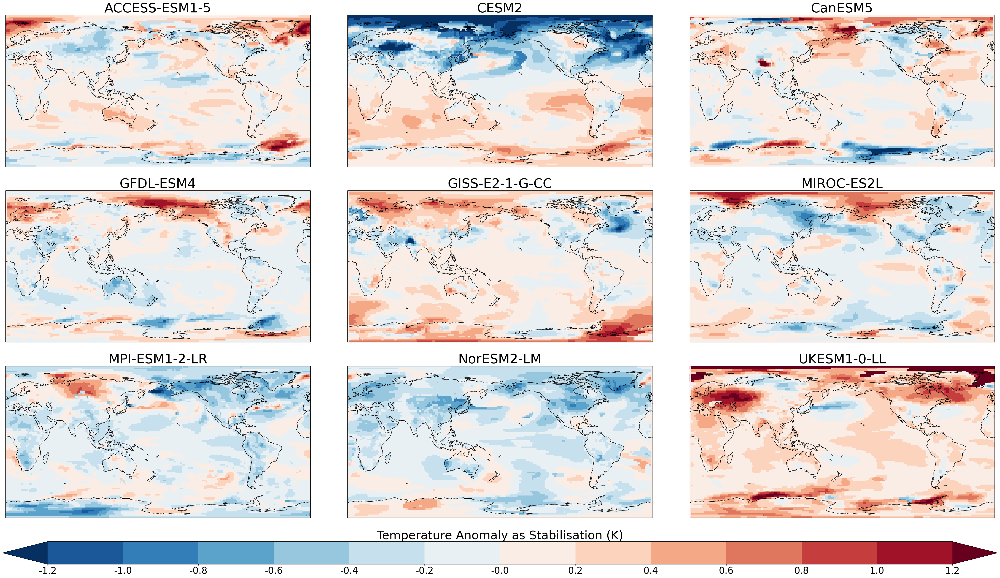

In [123]:
# Temperature anomaly at stabilisation for the year 20
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(stable_anom_da.sel(window=20), dim='model', projection=ccrs.PlateCarree,
                                                      levels=levels_anom, cbar_title="Temperature Anomaly as Stabilisation (K)",
                                                            ptype='imshow', add_label=False, font_scale=2)

In [124]:
def stippling(da, ax):
    X, Y = np.meshgrid(da.lon, da.lat)
    ax.scatter(X,Y, da.values, c='k', transform=ccrs.PlateCarree())

In [125]:
vm = 1.8; step=.2; levels_anom = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.

In [126]:
max_effective_length

60

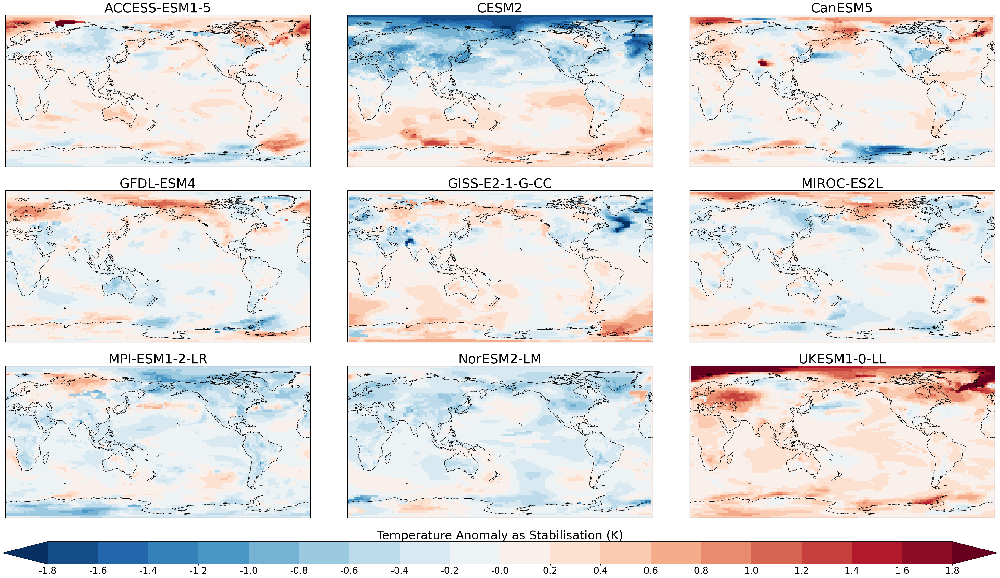

In [127]:
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(stable_anom_da.sel(window=40), dim='model', levels=levels_anom, 
                         cbar_title="Temperature Anomaly as Stabilisation (K)", projection=ccrs.PlateCarree, add_label=False, font_scale=2, 
                                                            logginglevel='ERROR', ptype='imshow')

# # Stippling the regions where stabilisation occurs later than the max effective length
for ax in axes:
    model = ax.get_title()
    da = rolling_year_stable_local.sel(window=40, model=model).time.squeeze()
    da = xr.where(da>max_effective_length, 1,0)
    stippling(da, ax)

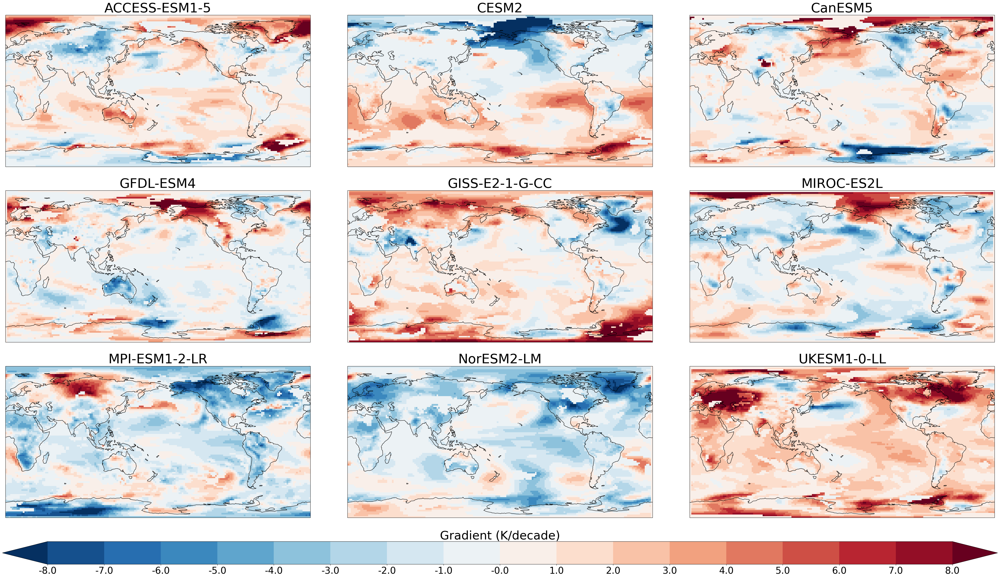

In [128]:
vm = .8; step=.1; levels_grad = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(gradient_da.sel(window=20)*10, dim='model', add_label=False,
                                                      levels=levels_grad*10, cbar_title="Gradient (K/decade)", ptype='imshow',
                                                      font_scale=2, projection=ccrs.PlateCarree,)

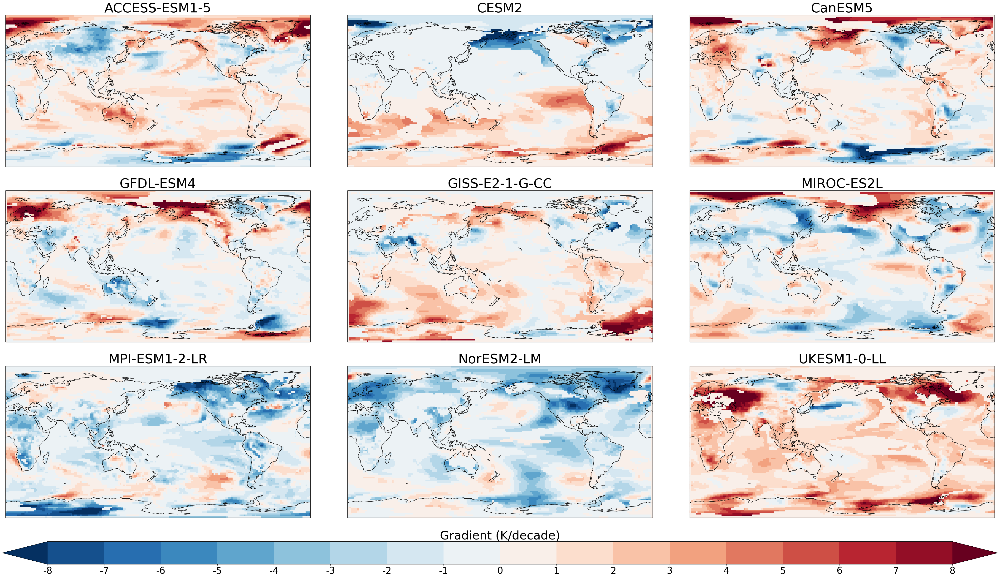

In [129]:
vm = 8; step=1; levels_grad = np.arange(-vm, vm+step, step) # based upon 99th percentile of abs.
fig, gs, axes, cbar = sn_plotting.map_plot_all_for_coords_3(gradient_da.sel(window=40)*10, dim='model', add_label=False,
                                                      levels=levels_grad, cbar_title="Gradient (K/decade)",ptype='imshow',
                                                      font_scale=2, projection=ccrs.PlateCarree,)

# Drift Comparison

In [130]:
#### TODO: Do not import as *. Add drift_functino. as prefix to all necissary functions
from drift_functions import *

In [131]:
# P-values
pi_pval_da = calculate_pvals(esmpi_ds.isel(time=slice(0, 100)))

- full garbage collection released 156.41 MiB from 89564 reference cycles (threshold: 9.54 MiB)
- Connection to tcp://127.0.0.1:32934 has been closed.
- Remove worker <WorkerState 'tcp://127.0.0.1:38917', name: 6, status: running, memory: 0, processing: 0> (stimulus_id='handle-worker-cleanup-1713920697.823077')
- Connection to tcp://127.0.0.1:32896 has been closed.
- Remove worker <WorkerState 'tcp://127.0.0.1:38745', name: 3, status: running, memory: 0, processing: 0> (stimulus_id='handle-worker-cleanup-1713920697.839564')
- Connection to tcp://127.0.0.1:32924 has been closed.
- Remove worker <WorkerState 'tcp://127.0.0.1:37597', name: 1, status: running, memory: 0, processing: 0> (stimulus_id='handle-worker-cleanup-1713920697.8418112')
- Connection to tcp://127.0.0.1:32898 has been closed.
- Remove worker <WorkerState 'tcp://127.0.0.1:34567', name: 5, status: running, memory: 0, processing: 0> (stimulus_id='handle-worker-cleanup-1713920697.844979')
- Connection to tcp://127.0.0.1:329

Process Dask Worker process (from Nanny):
Process Dask Worker process (from Nanny):
Process Dask Worker process (from Nanny):
Process Dask Worker process (from Nanny):
2024-04-24 11:04:57,965 - distributed.nanny - ERROR - Worker process died unexpectedly
Process Dask Worker process (from Nanny):
2024-04-24 11:04:57,965 - distributed.nanny - ERROR - Worker process died unexpectedly
2024-04-24 11:04:57,965 - distributed.nanny - ERROR - Worker process died unexpectedly
Process Dask Worker process (from Nanny):
Process Dask Worker process (from Nanny):
2024-04-24 11:04:57,969 - distributed.nanny - ERROR - Worker process died unexpectedly
Traceback (most recent call last):
  File "/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.10/lib/python3.10/site-packages/distributed/nanny.py", line 1014, in _run
    asyncio_run(run(), loop_factory=get_loop_factory())
  File "/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.10/lib/python3.10/site-packages/distributed/compatibility.py", line 236

In [ ]:
exp_pval_da = calculate_pvals(a1_anom_ds)

In [ ]:
exp_pval_da.isel(model=0).plot()

In [ ]:
# Just the p-values that are less tha 0.05
pi_sig_da = xr.where(pi_pval_da < 0.05, 1, np.nan)#.astype(int)
exp_sig_da = xr.where(exp_pval_da < 0.05, 1, np.nan)#.astype(int)

In [ ]:
fig = plt.figure(); ax = fig.add_subplot(111, projection=ccrs.Robinson())
sn_plotting.plot_stippled_data(pi_sig_da.isel(model=0), ax)

In [ ]:
# Calculating the gradient over the 100 year run length
gradient_exp_full_da = calculate_trend(a1_anom_ds);
gradient_pi_full_da = calculate_trend(esmpi_ds.isel(time=slice(0, 100)))

In [ ]:
# Multiplying gradient by 50 to get K per 50 years
gradient_exp_full_da = (gradient_exp_full_da*50).persist()
gradient_pi_full_da = (gradient_pi_full_da*50).persist()

In [ ]:
# Difference in the gradients
gradient_full_diff = gradient_exp_full_da-gradient_pi_full_da

In [ ]:
reload(sn_plotting)

In [ ]:
# All mean value plots
models = gradient_full_diff.model.values
nrows = len(models); ncols = 3
fig = plt.figure(figsize=(6*ncols, 8*ncols))
gs = gridspec.GridSpec(nrows+1, ncols, height_ratios = [1]*nrows +[0.2], hspace=.2, wspace=0)
projection = ccrs.PlateCarree(central_longitude=int(np.mean(gradient_full_diff.lon.values)))

drift_plot_levels = np.arange(-1.4, 1.4, .2)
drift_plot_kwargs = dict(levels=drift_plot_levels, extend='both', cmap='RdBu_r', add_label=False, font_scale=0.7)
vm =40; step=5; levels_mean_stab2 = np.arange(0, vm+step, step)
all_axes = []

### A1

fig, gs, axes1 = sn_plotting.map_plot_all_for_coords_3(
    gradient_exp_full_da, dim='model',
    fig=fig, gs=gs, add_colorbar=False, stipling_da=exp_sig_da,
    axes = [fig.add_subplot(gs[i, 0], projection=projection) for i in range(len(models))],
    **drift_plot_kwargs)

for num, (ax, model) in enumerate(zip(axes1, models)):
    # ax.set_ylabel(model, labelpad=500)
    # sn_plotting.plot_stippled_data(pi_sig_da.sel(model=model), ax) # TODO: This is not working in the `map_plot_all_for_coords_3` function
    if num == 0: ax.set_title('A1 Experiment', fontsize=constants.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
    else: ax.set_title('')
    
y_axis_kwargs = dict(xy=(-.25, 0.5), ha='center', va='center', xycoords='axes fraction', rotation=0,
                     size=constants.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
for model, ax in zip(models, axes1): ax.annotate(model, **y_axis_kwargs)
all_axes.extend(axes1)


#### Pi-control

fig, gs, axes2 = sn_plotting.map_plot_all_for_coords_3(
    gradient_pi_full_da, dim='model',
    fig=fig, gs=gs, add_colorbar=False,stipling_da=pi_sig_da, 
    axes = [fig.add_subplot(gs[i, 1], projection=projection) for i in range(len(models))],
    **drift_plot_kwargs)
for ax in axes2: ax.set_title('')
axes2[0].set_title('Pre-Industrial Control', size=constants.PlotConfig.title_size*drift_plot_kwargs['font_scale'])

all_axes.extend(axes2)

### Diff

fig, gs, axes3, cbar = sn_plotting.map_plot_all_for_coords_3(
    gradient_full_diff, dim='model',
    cbar_title="Gradient (K /(50 year))", fig=fig, gs=gs,
    axes = [fig.add_subplot(gs[i, 2], projection=projection) for i in range(len(models))],
    cax = plt.subplot(gs[nrows, :]), 
    **drift_plot_kwargs)


for ax in axes3: ax.set_title('')
axes3[0].set_title('Difference', size=constants.PlotConfig.title_size*drift_plot_kwargs['font_scale'])
all_axes.extend(axes3)

#for num, ax in enumerate(all_axes): plotting_functions.add_figure_label(ax, f'{chr(97+num)})', font_scale=0.7)

# Experimental Signal Calculation
Average signal in the first 20 years


In [ ]:
av_sig_ds = sn_multi_rolling_ds.signal.isel(time=slice(0, 19)).mean(dim='time')

In [ ]:
av_sig_ds.isel(window=0).plot(col='model', col_wrap=3, robust=True)


In [ ]:
#client.close()

- Worker process 3492723 was killed by signal 2
- Worker process 3492732 was killed by signal 2
- Closing Nanny at 'tcp://127.0.0.1:45793'. Reason: nanny-close-gracefully
- Closing Nanny at 'tcp://127.0.0.1:41393'. Reason: nanny-close-gracefully
- Worker process 3492740 was killed by signal 2
- Worker process 3492719 was killed by signal 2
- Worker process 3492728 was killed by signal 2
- Worker process 3492743 was killed by signal 2
- Worker process 3492735 was killed by signal 2
- Closing Nanny at 'tcp://127.0.0.1:45789'. Reason: nanny-close-gracefully
- Closing Nanny at 'tcp://127.0.0.1:39349'. Reason: nanny-close-gracefully
- Closing Nanny at 'tcp://127.0.0.1:40101'. Reason: nanny-close-gracefully
- Closing Nanny at 'tcp://127.0.0.1:45953'. Reason: nanny-close-gracefully
- Closing Nanny at 'tcp://127.0.0.1:44361'. Reason: nanny-close-gracefully
